In [1]:
import pandas as pd ##
import numpy as np ##
import seaborn as sns ## plotting
import matplotlib.pyplot as plt ## # plotting


In [2]:
import os
import pandas as pd

#change your directory please! 
data_path = "C:/Users/gebruiker/Documents/Sanne/UM GZW/Master Systems Biology/MSB1015 Scientific Programming/Data/alzheimer_s_disease_and_healthy_aging_data.csv"
if not os.path.exists(data_path):
    raise FileNotFoundError(
        f"Dataset not found at {data_path}. "
        "Please manually place the dataset in the 'data/' folder (do not upload it to GitHub)."
    )

StratifiedAlzheimers = pd.read_csv(data_path)
print("Dataset successfully loaded:", StratifiedAlzheimers.shape)

Dataset successfully loaded: (284142, 31)


# Data exploration

In [25]:
StratifiedAlzheimers.describe()

,YearStart,YearEnd,Data_Value,Data_Value_Alt,Low_Confidence_Limit,High_Confidence_Limit,LocationID
count,284142.000000,284142.000000,192808.000000,192808.000000,192597.000000,192597.000000,284142.000000
mean,2018.596065,2018.657735,37.676757,37.676757,33.027824,42.595333,800.322677
std,2.302815,2.360105,25.213484,25.213484,24.290016,26.156408,2511.564977
min,2015.000000,2015.000000,0.000000,0.000000,-0.700000,1.300000,1.000000
25%,2017.000000,2017.000000,15.900000,15.900000,12.600000,19.700000,19.000000
50%,2019.000000,2019.000000,32.800000,32.800000,27.000000,38.900000,34.000000
75%,2021.000000,2021.000000,56.900000,56.900000,49.400000,64.600000,49.000000
max,2022.000000,2022.000000,100.000000,100.000000,99.600000,100.000000,9004.000000


In [26]:
StratifiedAlzheimers.dtypes

RowId                          object
YearStart                       int64
YearEnd                         int64
LocationAbbr                   object
LocationDesc                   object
Datasource                     object
Class                          object
Topic                          object
Question                       object
Data_Value_Unit                object
DataValueTypeID                object
Data_Value_Type                object
Data_Value                    float64
Data_Value_Alt                float64
Data_Value_Footnote_Symbol     object
Data_Value_Footnote            object
Low_Confidence_Limit          float64
High_Confidence_Limit         float64
StratificationCategory1        object
Stratification1                object
StratificationCategory2        object
Stratification2                object
Geolocation                    object
ClassID                        object
TopicID                        object
QuestionID                     object
LocationID  

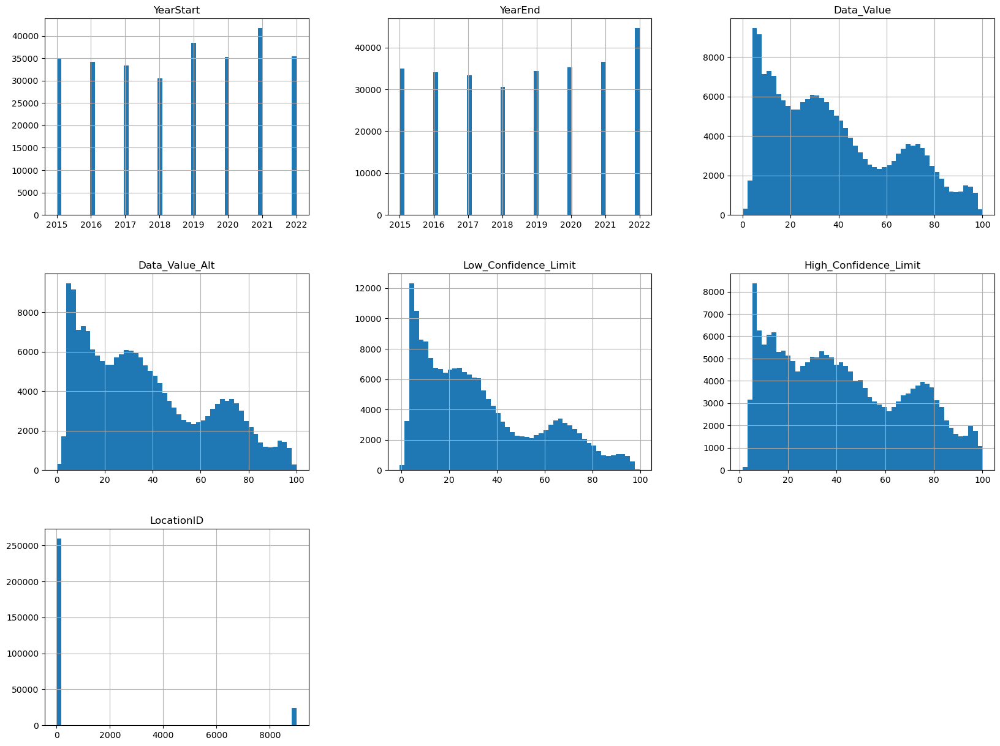

In [27]:
import matplotlib.pyplot as plt
StratifiedAlzheimers.hist(bins=50, figsize=(20,15))
plt.show()

In [30]:
StratifiedAlzheimers.Class.value_counts()


Class
Overall Health                         96753
Screenings and Vaccines                62153
Nutrition/Physical Activity/Obesity    33194
Caregiving                             25493
Mental Health                          22184
Smoking and Alcohol Use                22183
Cognitive Decline                      22182
Name: count, dtype: int64

In [31]:
StratifiedAlzheimers.Topic.value_counts()


Topic
Frequent mental distress                                                                                  11092
No leisure-time physical activity within past month                                                       11092
Physically unhealthy days (mean number of days)                                                           11092
Lifetime diagnosis of depression                                                                          11092
Influenza vaccine within past year                                                                        11092
Current smoking                                                                                           11092
Obesity                                                                                                   11092
Self-rated health (fair to poor health)                                                                   11091
Binge drinking within past 30 days                                                                

In [32]:
StratifiedAlzheimers.Question.value_counts()

Question
Percentage of older adults who are experiencing frequent mental distress                                                                                                     11092
Percentage of older adults who have not had any leisure time physical activity in the past month                                                                             11092
Physically unhealthy days (mean number of days in past month)                                                                                                                11092
Percentage of older adults with a lifetime diagnosis of depression                                                                                                           11092
Percentage of older adults who reported influenza vaccine within the past year                                                                                               11092
Percentage of older adults who have smoked at least 100 cigarettes in their entire life and stil

In [58]:
topic_year_counts = StratifiedAlzheimers.groupby(['Topic', 'YearStart']).size().unstack(fill_value=0)

topic_year_counts

YearStart,2015,2016,2017,2018,2019,2020,2021,2022
Topic,,,,,,,,
Arthritis among older adults,1287,0,1289,0,1263,1288,1287,1313
Binge drinking within past 30 days,1287,1310,1288,1287,1263,1288,1287,1313
Cholesterol checked in past 5 years,1287,0,1289,0,1263,0,1287,0
Colorectal cancer screening,0,1310,0,1287,0,1288,0,1312
Current smoking,1287,1310,1289,1287,1263,1288,1287,1313
Diabetes screening within past 3 years,381,662,932,759,644,878,503,645
"Disability status, including sensory or mobility limitations",0,1310,1289,1287,1263,1288,1287,1313
Duration of caregiving among older adults,568,491,305,141,252,205,1854,362
Eating 2 or more fruits daily,1286,0,1288,0,1262,0,1286,0


In [59]:

# Stel opties in om alles te tonen
pd.set_option('display.max_rows', None)       # Toon alle rijen
pd.set_option('display.max_columns', None)    # Toon alle kolommen
pd.set_option('display.width', None)          # Pas breedte automatisch aan
pd.set_option('display.max_colwidth', None)   # Toon volledige celinhoud

#count data_value per class per topic per state per year
class_topic_year_location_counts = StratifiedAlzheimers.groupby(['Class', 'Topic', 'YearStart', 'LocationAbbr']).size().unstack(fill_value=0)
class_topic_year_location_counts

LocationAbbr                                                                                                                                          AK  \
Class                               Topic                                                                                                  YearStart       
Caregiving                          Duration of caregiving among older adults                                                              2015        0   
                                                                                                                                           2016        0   
                                                                                                                                           2017       24   
                                                                                                                                           2018        0   
                                                                                                                                           2019        0   
                                                                                                                                           2020        0   
                                                                                                                                           2021       48   
                                                                                                                                           2022        0   
                                    Expect to provide care for someone in the next two years                                               2015        0   
                                                                                                                                           2016        0   
                                                                                                                                           2017       24   
                                                                                                                                           2018        0   
                                                                                                                                           2019        0   
                                                                                                                                           2020        0   
                                                                                                                                           2021       48   
                                                                                                                                           2022        0   
                                    Intensity of caregiving among older adults                                                             2015        0   
                                                                                                                                           2016        0   
                                                                                                                                           2017       24   
                                                                                                                                           2018        0   
                                                                                                                                           2019        0   
                                                                                                                                           2020        0   
                                                                                                                                           2021       48   
                                                                                                    

In [60]:
#reset back to default options

pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')
pd.reset_option('display.width')
pd.reset_option('display.max_colwidth')

In [33]:
for col in StratifiedAlzheimers.columns:
    print(f"Value counts voor kolom: {col}")
    print(StratifiedAlzheimers[col].value_counts())
    print("-" * 40)

Value counts voor kolom: RowId
RowId
BRFSS~2022~2022~42~Q03~TMC01~AGE~RACE       15
BRFSS~2017~2017~12~Q22~TSC07~AGE~RACE       15
BRFSS~2019~2019~11~Q27~TMC03~AGE~RACE       15
BRFSS~2015~2015~08~Q45~TOC13~AGE~RACE       15
BRFSS~2019~2019~11~Q33~TOC08~AGE~RACE       15
                                            ..
BRFSS~2016~2016~18~Q16~TNC03~AGE~OVERALL     3
BRFSS~2016~2016~18~Q21~TAC03~AGE~OVERALL     3
BRFSS~2018~2018~18~Q03~TMC01~AGE~OVERALL     3
BRFSS~2016~2016~21~Q05~TOC06~AGE~OVERALL     3
BRFSS~2016~2016~56~Q32~TOC07~AGE~OVERALL     3
Name: count, Length: 36046, dtype: int64
----------------------------------------
Value counts voor kolom: YearStart
YearStart
2021    41779
2019    38485
2022    35426
2020    35310
2015    35020
2016    34145
2017    33429
2018    30548
Name: count, dtype: int64
----------------------------------------
Value counts voor kolom: YearEnd
YearEnd
2022    44687
2021    36649
2020    35310
2015    35020
2019    34354
2016    34145
2017    33429
2

# Check for missing values

Now, through stratification, the missing values are less than the other dataset (Luckily!)
No special need for imputation

In [3]:
StratifiedAlzheimers.isnull().sum()

RowId                              0
YearStart                          0
YearEnd                            0
LocationAbbr                       0
LocationDesc                       0
Datasource                         0
Class                              0
Topic                              0
Question                           0
Data_Value_Unit                    0
DataValueTypeID                    0
Data_Value_Type                    0
Data_Value                     91334
Data_Value_Alt                 91334
Data_Value_Footnote_Symbol    174166
Data_Value_Footnote           174166
Low_Confidence_Limit           91545
High_Confidence_Limit          91545
StratificationCategory1            0
Stratification1                    0
StratificationCategory2        36873
Stratification2                36873
Geolocation                    30489
ClassID                            0
TopicID                            0
QuestionID                         0
LocationID                         0
S

In [4]:
missing_percent = StratifiedAlzheimers.isnull().mean() * 100

# Filter kolommen met meer dan 30% missende waarden
columns_above_30 = missing_percent[missing_percent > 30]

# Toon de kolomnamen en hun missings-percentage
print(columns_above_30)

Data_Value                    32.143787
Data_Value_Alt                32.143787
Data_Value_Footnote_Symbol    61.295409
Data_Value_Footnote           61.295409
Low_Confidence_Limit          32.218046
High_Confidence_Limit         32.218046
dtype: float64


NameError: name 'plt' is not defined

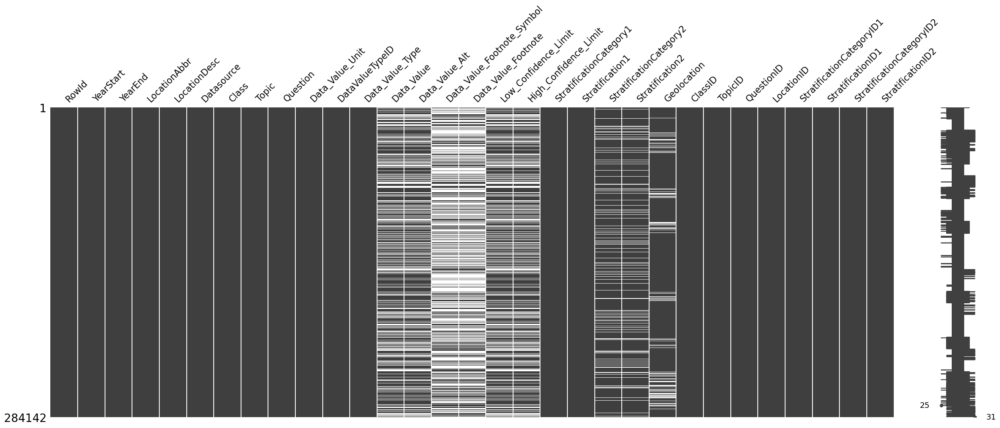

In [5]:
import missingno

missingno.matrix(StratifiedAlzheimers, figsize = (30,10))
plt.show()

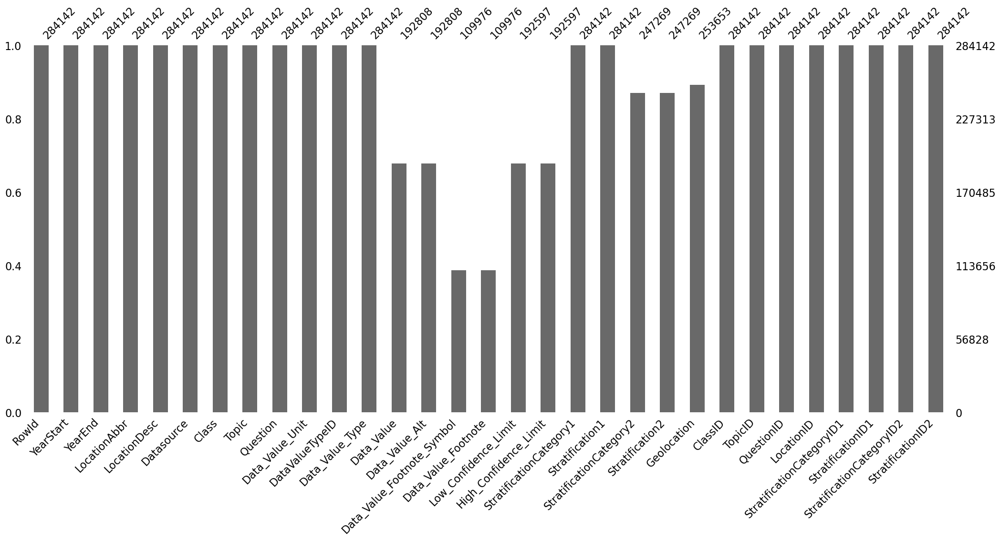

In [ ]:
missingno.bar(StratifiedAlzheimers)
plt.show()

QuestionID                                                                                                                                                                  Question
       Q03                                                                                                  Percentage of older adults who are experiencing frequent mental distress
       Q46 Percentage of older adults who report having a disability (includes limitations related to sensory or mobility impairments or a physical, mental, or emotional condition)
       Q07                                                                            Percentage of older adults who report having lost 5 or fewer teeth due to decay or gum disease
       Q09                                       Percentage of at risk adults (have diabetes, asthma, cardiovascular disease or currently smoke) who ever had a pneumococcal vaccine
       Q10                                                                                 Perc

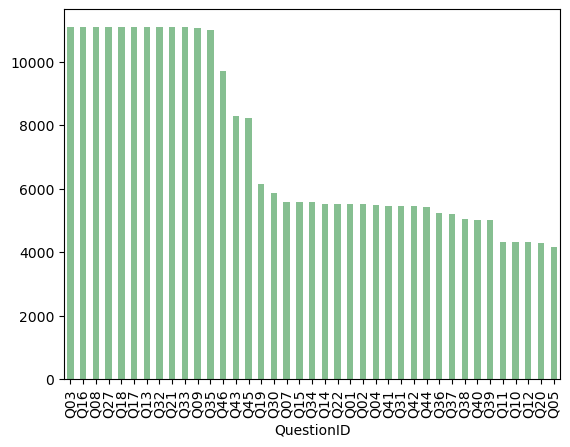

In [ ]:
StratifiedAlzheimers['QuestionID'].value_counts().plot(kind='bar', color='#86bf91')
unique_pairs = StratifiedAlzheimers.drop_duplicates(subset=['QuestionID', 'Question'])
selected_columns = unique_pairs[['QuestionID', 'Question']]
print(selected_columns.to_string(index=False))
plt.show()

# Barplots per column

Categorische kolommen gevonden:
['RowId', 'LocationAbbr', 'LocationDesc', 'Datasource', 'Class', 'Topic', 'Question', 'Data_Value_Unit', 'DataValueTypeID', 'Data_Value_Type', 'Data_Value_Footnote_Symbol', 'Data_Value_Footnote', 'StratificationCategory1', 'Stratification1', 'StratificationCategory2', 'Stratification2', 'Geolocation', 'ClassID', 'TopicID', 'QuestionID', 'StratificationCategoryID1', 'StratificationID1', 'StratificationCategoryID2', 'StratificationID2']

 Kolom: RowId
RowId
BRFSS~2022~2022~42~Q03~TMC01~AGE~RACE    15
BRFSS~2017~2017~12~Q22~TSC07~AGE~RACE    15
BRFSS~2019~2019~11~Q27~TMC03~AGE~RACE    15
BRFSS~2015~2015~08~Q45~TOC13~AGE~RACE    15
BRFSS~2019~2019~11~Q33~TOC08~AGE~RACE    15
BRFSS~2016~2016~06~Q07~TOC05~AGE~RACE    15
BRFSS~2016~2016~11~Q33~TOC08~AGE~RACE    15
BRFSS~2019~2019~08~Q43~TOC11~AGE~RACE    15
BRFSS~2016~2016~09~Q05~TOC06~AGE~RACE    15
BRFSS~2016~2016~08~Q08~TOC01~AGE~RACE    15
Name: count, dtype: int64

 Kolom: LocationAbbr
LocationAbbr
US     

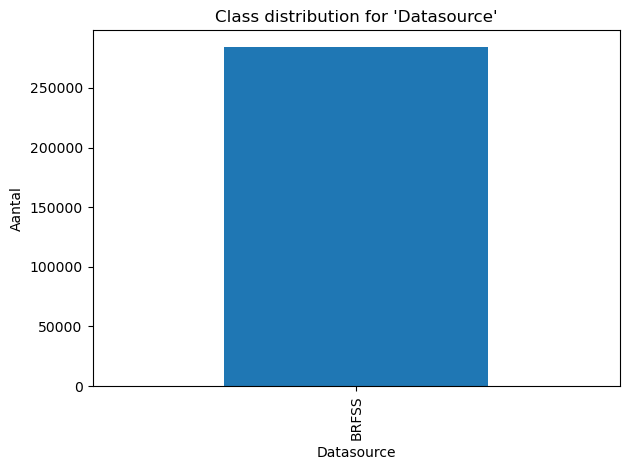


 Kolom: Class
Class
Overall Health                         96753
Screenings and Vaccines                62153
Nutrition/Physical Activity/Obesity    33194
Caregiving                             25493
Mental Health                          22184
Smoking and Alcohol Use                22183
Cognitive Decline                      22182
Name: count, dtype: int64


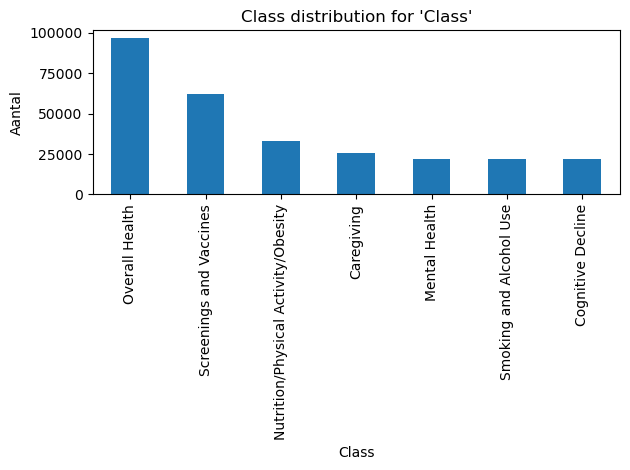


 Kolom: Topic
Topic
Frequent mental distress                               11092
No leisure-time physical activity within past month    11092
Physically unhealthy days (mean number of days)        11092
Lifetime diagnosis of depression                       11092
Influenza vaccine within past year                     11092
Current smoking                                        11092
Obesity                                                11092
Self-rated health (fair to poor health)                11091
Binge drinking within past 30 days                     11091
Self-rated health (good to excellent health)           11091
Name: count, dtype: int64

 Kolom: Question
Question
Percentage of older adults who are experiencing frequent mental distress                                                          11092
Percentage of older adults who have not had any leisure time physical activity in the past month                                  11092
Physically unhealthy days (mean number of da

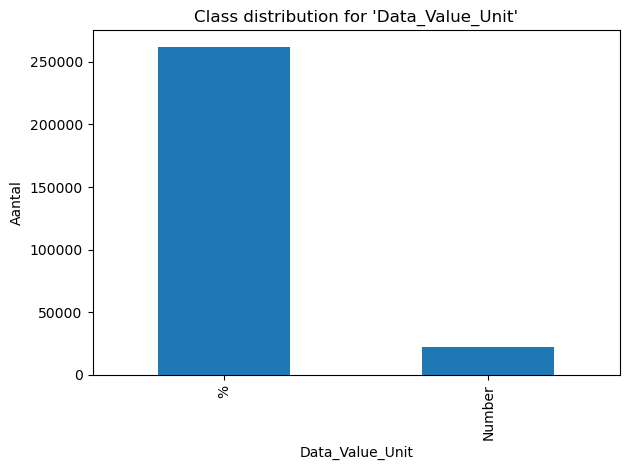


 Kolom: DataValueTypeID
DataValueTypeID
PRCTG    262048
MEAN      22094
Name: count, dtype: int64


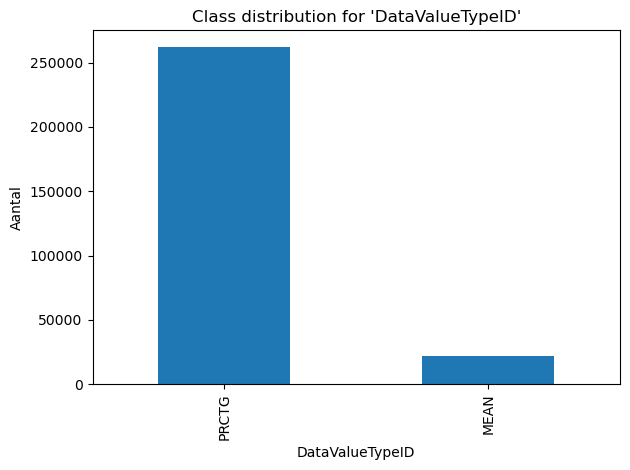


 Kolom: Data_Value_Type
Data_Value_Type
Percentage    262048
Mean           22094
Name: count, dtype: int64


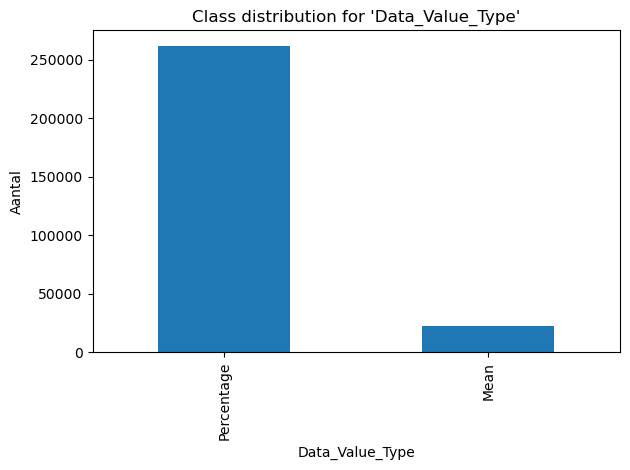


 Kolom: Data_Value_Footnote_Symbol
Data_Value_Footnote_Symbol
NaN     174166
****     78875
&        14224
~        12459
#         3361
**        1057
Name: count, dtype: int64


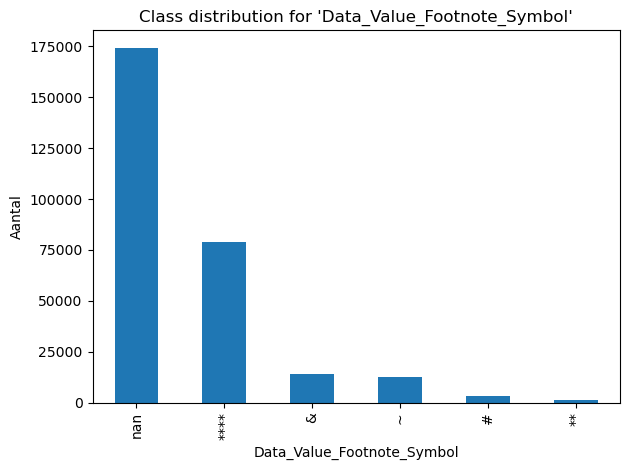


 Kolom: Data_Value_Footnote
Data_Value_Footnote
NaN                                                                                                                                174166
Sample size of denominator and/or age group for age-standardization is less than 50 or relative standard error is more than 30%     78875
Regional estimates may not represent all states in the region                                                                       14224
No Data Available                                                                                                                   12459
Fewer than 50 States reporting                                                                                                       3361
Estimate is not comparable to those generated using data from years prior to 2019 due to survey question changes                     1057
Name: count, dtype: int64


C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\27619956.py:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


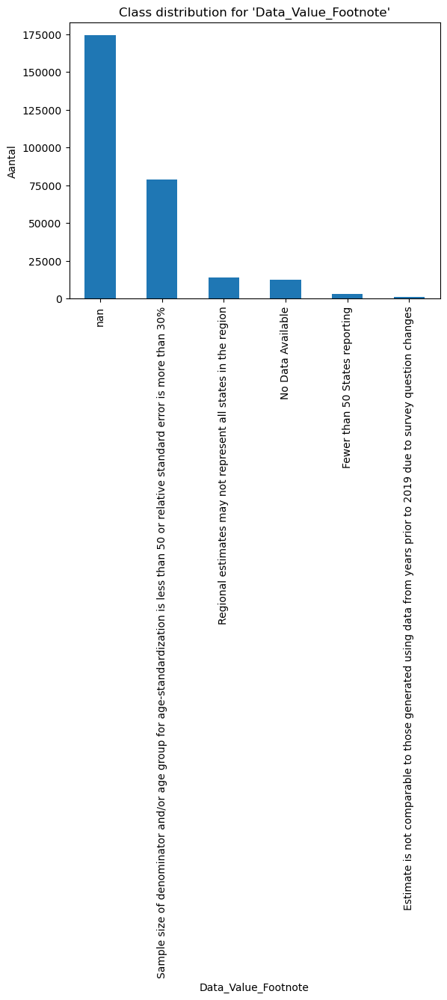


 Kolom: StratificationCategory1
StratificationCategory1
Age Group    284142
Name: count, dtype: int64


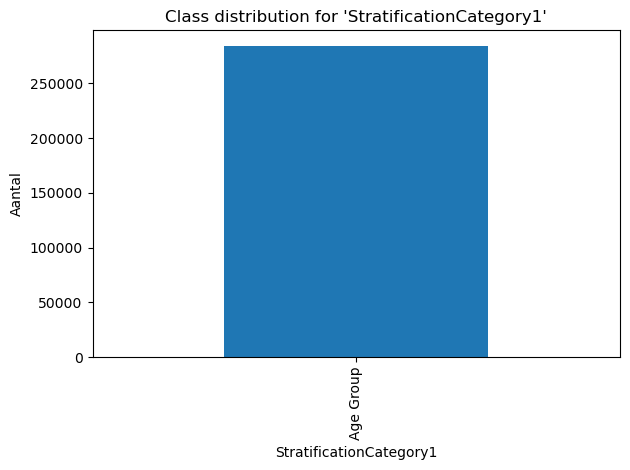


 Kolom: Stratification1
Stratification1
Overall              95233
50-64 years          94741
65 years or older    94168
Name: count, dtype: int64


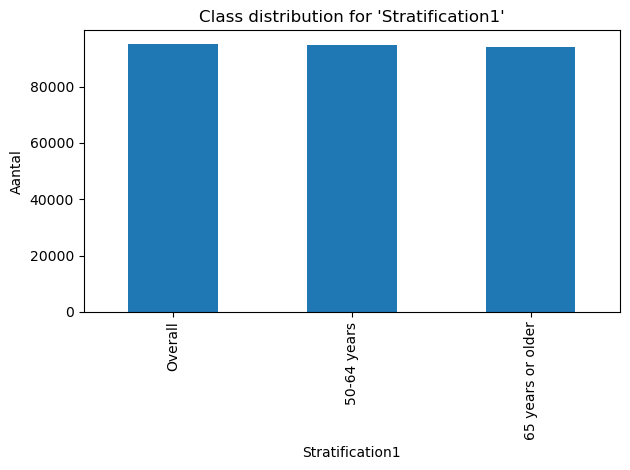


 Kolom: StratificationCategory2
StratificationCategory2
Race/Ethnicity    178431
Gender             68838
NaN                36873
Name: count, dtype: int64


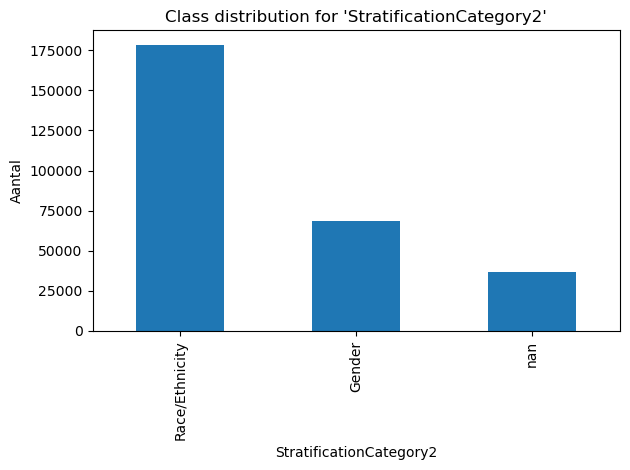


 Kolom: Stratification2
Stratification2
NaN                         36873
White, non-Hispanic         36450
Hispanic                    36326
Black, non-Hispanic         35770
Native Am/Alaskan Native    35021
Asian/Pacific Islander      34864
Female                      34596
Male                        34242
Name: count, dtype: int64


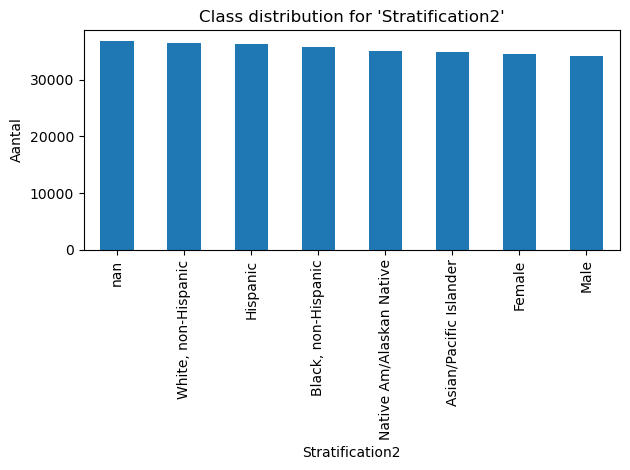


 Kolom: Geolocation
Geolocation
NaN                                 30489
POINT (-120.1550313 44.56744942)     5916
POINT (-75.54397043 42.82700103)     5787
POINT (-111.5871306 39.36070017)     5368
POINT (-82.40426006 40.06021014)     5311
POINT (-157.8577494 21.30485044)     5164
POINT (-76.60926011 39.29058096)     5132
POINT (-83.62758035 32.83968109)     5124
POINT (-84.71439027 44.66131954)     5113
POINT (-117.0718406 39.49324039)     4950
Name: count, dtype: int64

 Kolom: ClassID
ClassID
C01    96753
C03    62153
C02    33194
C07    25493
C05    22184
C04    22183
C06    22182
Name: count, dtype: int64


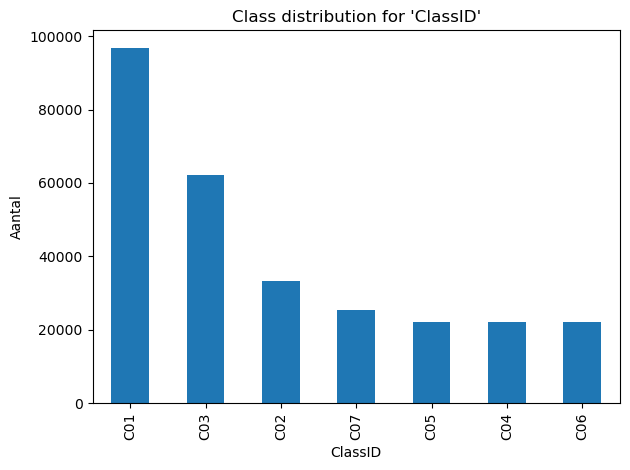


 Kolom: TopicID
TopicID
TMC01    11092
TNC03    11092
TOC01    11092
TMC03    11092
TSC08    11092
TAC01    11092
TNC04    11092
TOC07    11091
TAC03    11091
TOC08    11091
Name: count, dtype: int64

 Kolom: QuestionID
QuestionID
Q03    11092
Q16    11092
Q08    11092
Q27    11092
Q18    11092
Q17    11092
Q13    11092
Q32    11091
Q21    11091
Q33    11091
Name: count, dtype: int64

 Kolom: StratificationCategoryID1
StratificationCategoryID1
AGE    284142
Name: count, dtype: int64


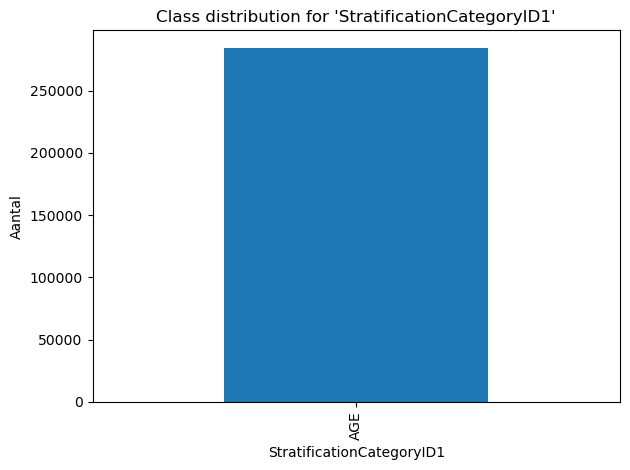


 Kolom: StratificationID1
StratificationID1
AGE_OVERALL    95233
5064           94741
65PLUS         94168
Name: count, dtype: int64


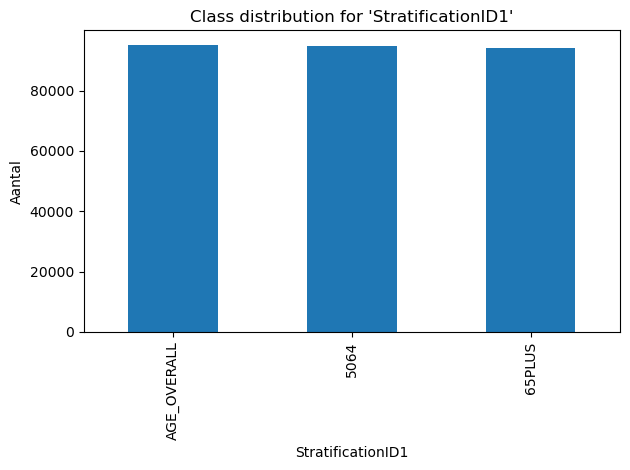


 Kolom: StratificationCategoryID2
StratificationCategoryID2
RACE       178431
GENDER      68838
OVERALL     36873
Name: count, dtype: int64


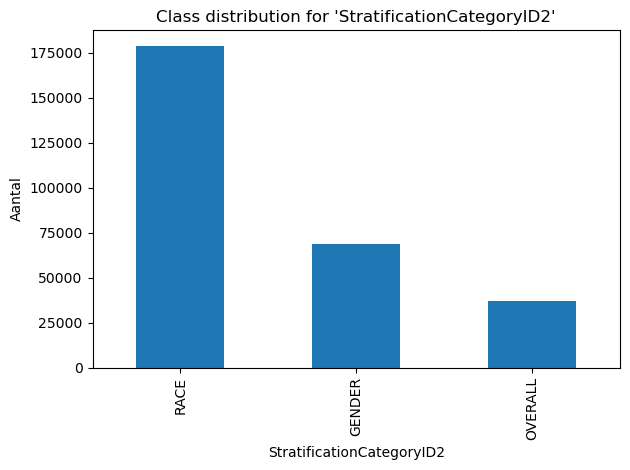


 Kolom: StratificationID2
StratificationID2
OVERALL    36873
WHT        36450
HIS        36326
BLK        35770
NAA        35021
ASN        34864
FEMALE     34596
MALE       34242
Name: count, dtype: int64


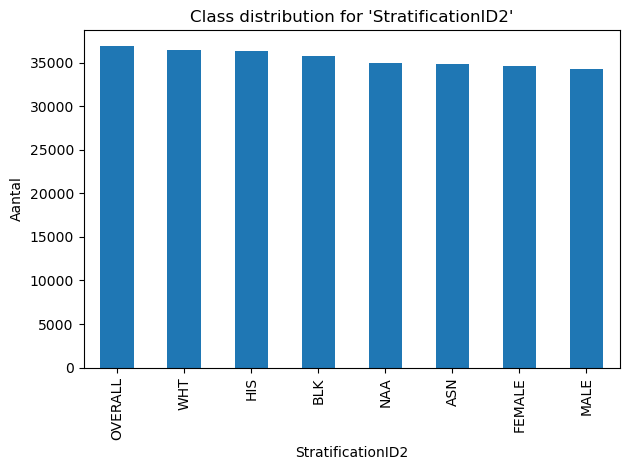

In [ ]:
# Look at categorical columns ===
categorical_cols = StratifiedAlzheimers.select_dtypes(include=['object']).columns.tolist()
print("Categorische kolommen gevonden:")
print(categorical_cols)

# Function to analyse class imbalance ===
def analyze_class_imbalance(df, columns, top_n=10):
    for col in columns:
        print(f"\n Kolom: {col}")
        value_counts = StratifiedAlzheimers[col].value_counts(dropna=False)
        print(value_counts.head(top_n))
        
        # Plot only when column has too many unieke values
        if value_counts.shape[0] <= 20:
            value_counts.plot(kind='bar')
            plt.title(f"Class distribution for '{col}'")
            plt.xlabel(col)
            plt.ylabel("Aantal")
            plt.tight_layout()
            plt.show()

# Run ===
analyze_class_imbalance(StratifiedAlzheimers, categorical_cols)

# PCA s

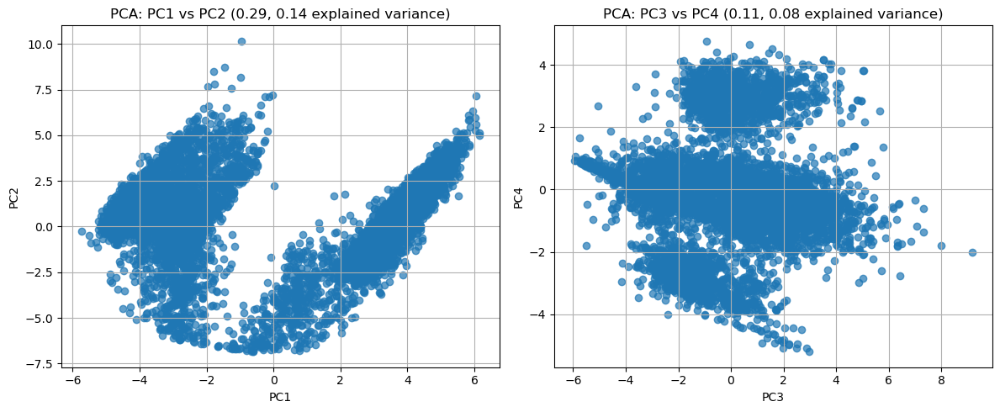

In [77]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
# Laad dataset and read csv
df = pd.read_csv("alzheimer_s_disease_and_healthy_aging_data.csv")

# Kies groeperinglevens (kan je aanpassen)
group_cols = ['LocationAbbr', 'YearStart', 'Stratification1', 'Stratification2']

# Filter eventueel op een redelijke set Topics die je wil meenemen (kan alle Topics zijn)
topics = StratifiedAlzheimers['Topic'].unique()  # voor alle Topics
# Of zelf bepalen, bijvoorbeeld:
# topics = ['Caregiving', 'Cognitive Decline', 'Mental Health', 
#          'Nutrition/Physical Activity/Obesity', 'Screenings and Vaccines', 
#          'Smoking and Alcohol Use', 'Overall Health']

StratifiedAlzheimers = StratifiedAlzheimers[StratifiedAlzheimers['Topic'].isin(topics)].copy()
StratifiedAlzheimers['Data_Value'] = pd.to_numeric(StratifiedAlzheimers['Data_Value'], errors='coerce')

# Maak pivot table: rijen = groep, kolommen = Topic, waarden = gemiddelde Data_Value
pivot = StratifiedAlzheimers.groupby(group_cols + ['Topic'])['Data_Value'].mean().reset_index()
# Na pivoteren
wide = pivot.pivot_table(index=group_cols, columns='Topic', values='Data_Value')

# Vul NA's met 0 (of eventueel gemiddelde) in plaats van droppen om lege dataframe te voorkomen
wide_filled = wide.fillna(0)

if wide_filled.shape[0] == 0:
    print("Data is leeg na filteren en vullen. Geen PCA mogelijk.")
else:
    from sklearn.preprocessing import StandardScaler
    from sklearn.decomposition import PCA
    import matplotlib.pyplot as plt

    # Standaardiseren
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(wide_filled.values)

    # PCA uitvoeren
    pca = PCA(n_components=4)
    X_pca = pca.fit_transform(X_scaled)

    # Visualisaties van PC1-2 en PC3-4
    plt.figure(figsize=(12,5))

    plt.subplot(1,2,1)
    plt.scatter(X_pca[:,0], X_pca[:,1], alpha=0.7)
    plt.title(f'PCA: PC1 vs PC2 ({pca.explained_variance_ratio_[0]:.2f}, {pca.explained_variance_ratio_[1]:.2f} explained variance)')
    plt.xlabel('PC1')
    plt.ylabel('PC2')
    plt.grid(True)

    plt.subplot(1,2,2)
    plt.scatter(X_pca[:,2], X_pca[:,3], alpha=0.7)
    plt.title(f'PCA: PC3 vs PC4 ({pca.explained_variance_ratio_[2]:.2f}, {pca.explained_variance_ratio_[3]:.2f} explained variance)')
    plt.xlabel('PC3')
    plt.ylabel('PC4')
    plt.grid(True)

    plt.tight_layout()
    plt.show()



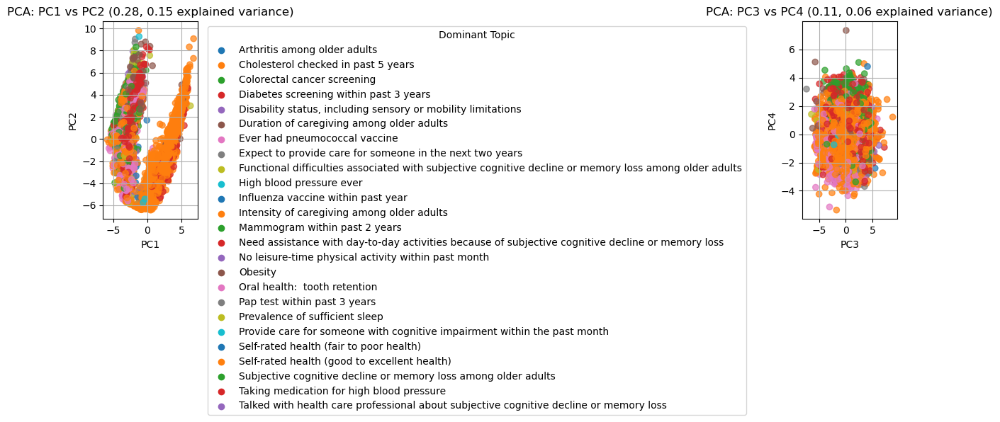

In [67]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import numpy as np

# Laad dataset
df = pd.read_csv("alzheimer_s_disease_and_healthy_aging_data.csv")

group_cols = ['LocationAbbr', 'YearStart', 'Stratification1', 'Stratification2']
topics = df['Topic'].unique()  
df = df[df['Topic'].isin(topics)].copy()
df['Data_Value'] = pd.to_numeric(df['Data_Value'], errors='coerce')

# Maak pivot table
pivot = df.groupby(group_cols + ['Topic'])['Data_Value'].mean().reset_index()
wide = pivot.pivot_table(index=group_cols, columns='Topic', values='Data_Value')
wide_filled = wide.fillna(0)

if wide_filled.shape[0] == 0:
    print("Data is leeg na filteren en vullen. Geen PCA mogelijk.")
else:
    # Dominant Topic per groep bepalen (voor kleuren)
    dominant_topic = wide_filled.idxmax(axis=1)  # kolomnaam met hoogste Data_Value
    topic_labels, topic_indices = np.unique(dominant_topic, return_inverse=True)

    # Standaardiseren
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(wide_filled.values)

    # PCA uitvoeren
    pca = PCA(n_components=4)
    X_pca = pca.fit_transform(X_scaled)

    # Kleuren instellen
    cmap = plt.get_cmap('tab10')
    colors = cmap(topic_indices % 10)  # maximaal 10 kleuren (herhaalt daarna)

    # Visualisaties van PC1-2 en PC3-4
    plt.figure(figsize=(12,5))

    plt.subplot(1,2,1)
    plt.scatter(X_pca[:,0], X_pca[:,1], alpha=0.7, c=colors)
    for i, topic in enumerate(topic_labels):
        plt.scatter([], [], color=cmap(i % 10), label=topic)  # lege punten voor legend
    plt.title(f'PCA: PC1 vs PC2 ({pca.explained_variance_ratio_[0]:.2f}, {pca.explained_variance_ratio_[1]:.2f} explained variance)')
    plt.xlabel('PC1')
    plt.ylabel('PC2')
    plt.legend(title="Dominant Topic", bbox_to_anchor=(1.05, 1))
    plt.grid(True)

    plt.subplot(1,2,2)
    plt.scatter(X_pca[:,2], X_pca[:,3], alpha=0.7, c=colors)
    plt.title(f'PCA: PC3 vs PC4 ({pca.explained_variance_ratio_[2]:.2f}, {pca.explained_variance_ratio_[3]:.2f} explained variance)')
    plt.xlabel('PC3')
    plt.ylabel('PC4')
    plt.grid(True)

    plt.tight_layout()
    plt.show()


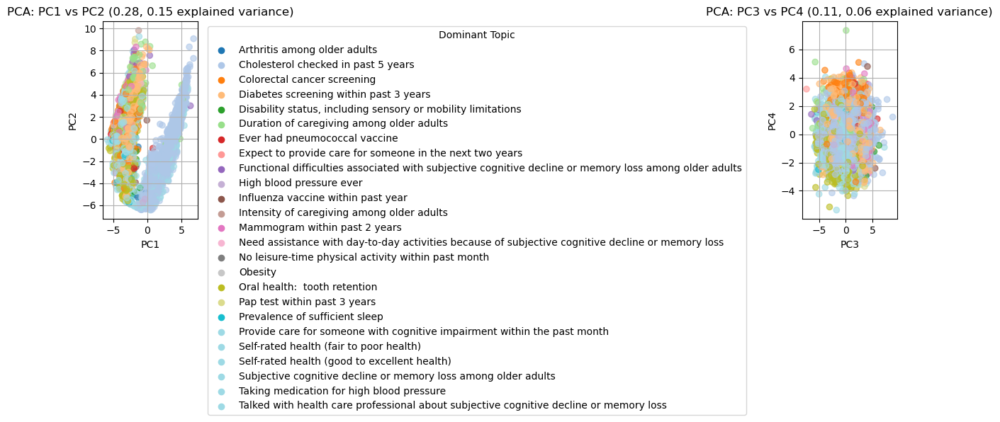

In [68]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import numpy as np

# Laad dataset
df = pd.read_csv("alzheimer_s_disease_and_healthy_aging_data.csv")

group_cols = ['LocationAbbr', 'YearStart', 'Stratification1', 'Stratification2']
topics = df['Topic'].unique()  
df = df[df['Topic'].isin(topics)].copy()
df['Data_Value'] = pd.to_numeric(df['Data_Value'], errors='coerce')

# Maak pivot table
pivot = df.groupby(group_cols + ['Topic'])['Data_Value'].mean().reset_index()
wide = pivot.pivot_table(index=group_cols, columns='Topic', values='Data_Value')
wide_filled = wide.fillna(0)

if wide_filled.shape[0] == 0:
    print("Data is leeg na filteren en vullen. Geen PCA mogelijk.")
else:
    # Dominant Topic per groep bepalen (voor kleuren)
    dominant_topic = wide_filled.idxmax(axis=1)  # kolomnaam met hoogste Data_Value
    topic_labels, topic_indices = np.unique(dominant_topic, return_inverse=True)

    # Standaardiseren
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(wide_filled.values)

    # PCA uitvoeren
    pca = PCA(n_components=4)
    X_pca = pca.fit_transform(X_scaled)

    # Kleuren instellen: unieke kleuren per Topic, transparant
    cmap = plt.get_cmap('tab20')  # tot 20 unieke kleuren
    colors = [cmap(i) for i in topic_indices]

    # Visualisaties van PC1-2 en PC3-4
    plt.figure(figsize=(12,5))

    plt.subplot(1,2,1)
    plt.scatter(X_pca[:,0], X_pca[:,1], alpha=0.6, c=colors)
    for i, topic in enumerate(topic_labels):
        plt.scatter([], [], color=cmap(i), label=topic)  # lege punten voor legend
    plt.title(f'PCA: PC1 vs PC2 ({pca.explained_variance_ratio_[0]:.2f}, {pca.explained_variance_ratio_[1]:.2f} explained variance)')
    plt.xlabel('PC1')
    plt.ylabel('PC2')
    plt.legend(title="Dominant Topic", bbox_to_anchor=(1.05, 1))
    plt.grid(True)

    plt.subplot(1,2,2)
    plt.scatter(X_pca[:,2], X_pca[:,3], alpha=0.6, c=colors)
    plt.title(f'PCA: PC3 vs PC4 ({pca.explained_variance_ratio_[2]:.2f}, {pca.explained_variance_ratio_[3]:.2f} explained variance)')
    plt.xlabel('PC3')
    plt.ylabel('PC4')
    plt.grid(True)

    plt.tight_layout()
    plt.show()


In [76]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import plotly.express as px
import numpy as np

# Laad dataset
df = pd.read_csv("alzheimer_s_disease_and_healthy_aging_data.csv")

group_cols = ['LocationAbbr', 'YearStart', 'Stratification1', 'Stratification2']
topics = df['Topic'].unique()  
df = df[df['Topic'].isin(topics)].copy()
df['Data_Value'] = pd.to_numeric(df['Data_Value'], errors='coerce')

# Maak pivot table
pivot = df.groupby(group_cols + ['Topic'])['Data_Value'].mean().reset_index()
wide = pivot.pivot_table(index=group_cols, columns='Topic', values='Data_Value')
wide_filled = wide.fillna(0)

if wide_filled.shape[0] == 0:
    print("Data is leeg na filteren en vullen. Geen PCA mogelijk.")
else:
    # Dominant Topic per groep bepalen (voor kleuren)
    dominant_topic = wide_filled.idxmax(axis=1)
    dominant_topic.name = "Dominant_Topic"

    # Standaardiseren
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(wide_filled.values)

    # PCA uitvoeren
    pca = PCA(n_components=4)
    X_pca = pca.fit_transform(X_scaled)

    # Voeg PCA-resultaten en metadata samen in dataframe voor Plotly
    plot_df = pd.DataFrame(X_pca[:, :4], columns=['PC1','PC2','PC3','PC4'], index=wide_filled.index)
    plot_df = plot_df.join(dominant_topic)
    plot_df.reset_index(inplace=True)

    # Maak lijst met 39 unieke kleuren
    # Gebruik Plotly's qualitative palette en herhaal indien nodig
    from plotly.colors import qualitative
    base_colors = qualitative.Plotly  # 10 kleuren
    colors_39 = base_colors * 4  # 10*4 = 40, genoeg voor 39 topics
    colors_39 = colors_39[:39]  # precies 39

    # Mapping van Topic naar kleur
    topic_list = plot_df['Dominant_Topic'].unique()
    topic_color_map = {topic: colors_39[i] for i, topic in enumerate(topic_list)}

    # Interactieve PCA plot PC1 vs PC2
    fig1 = px.scatter(
        plot_df, x='PC1', y='PC2',
        color='Dominant_Topic',
        color_discrete_map=topic_color_map,
        hover_data=group_cols,
        opacity=0.6,
        title=f'PCA: PC1 vs PC2 ({pca.explained_variance_ratio_[0]:.2f}, {pca.explained_variance_ratio_[1]:.2f} explained variance)'
    )

    # Interactieve PCA plot PC3 vs PC4
    fig2 = px.scatter(
        plot_df, x='PC3', y='PC4',
        color='Dominant_Topic',
        color_discrete_map=topic_color_map,
        hover_data=group_cols,
        opacity=0.6,
        title=f'PCA: PC3 vs PC4 ({pca.explained_variance_ratio_[2]:.2f}, {pca.explained_variance_ratio_[3]:.2f} explained variance)'
    )

    fig1.show()
    fig2.show()


In [ ]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import plotly.express as px

# --- 1. Load dataset ---
df = pd.read_csv("alzheimer_s_disease_and_healthy_aging_data.csv")

# --- 2. Define grouping columns ---
group_cols = ['LocationAbbr', 'YearStart', 'Stratification1', 'Stratification2']

# --- 3. Keep all 39 Topics ---
df['Data_Value'] = pd.to_numeric(df['Data_Value'], errors='coerce')

# --- 4. Pivot table: rows = group, columns = Topic, values = mean Data_Value ---
pivot = df.groupby(group_cols + ['Topic'])['Data_Value'].mean().reset_index()
wide = pivot.pivot_table(index=group_cols, columns='Topic', values='Data_Value')

# --- 5. Fill missing values ---
wide_filled = wide.fillna(0)

if wide_filled.shape[0] == 0:
    print("Data is empty after pivoting. No PCA possible.")
else:
    # === A. Dominant Topic per group ===
    dominant_topic = wide_filled.idxmax(axis=1)
    dominant_topic.name = "Dominant_Topic"

    # === B. Standardize ===
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(wide_filled.values)

    # === C. Perform PCA ===
    pca = PCA(n_components=4)
    X_pca = pca.fit_transform(X_scaled)

    # === D. Prepare DataFrame for plotting ===
    plot_df = pd.DataFrame(X_pca[:, :4], columns=['PC1','PC2','PC3','PC4'], index=wide_filled.index)
    plot_df = plot_df.join(dominant_topic)
    plot_df.reset_index(inplace=True)

    # === E. 39 distinct colors ===
    from plotly.colors import qualitative
    base_colors = qualitative.Alphabet
    while len(base_colors) < 39:
        base_colors += base_colors
    colors_39 = base_colors[:39]

    topic_list = sorted(plot_df['Dominant_Topic'].unique())
    topic_color_map = {topic: colors_39[i] for i, topic in enumerate(topic_list)}

    # === F. Interactive PCA plots ===
    fig1 = px.scatter(
        plot_df, x='PC1', y='PC2',
        color='Dominant_Topic',
        color_discrete_map=topic_color_map,
        hover_data=group_cols,
        opacity=0.6,
        title=f'PCA: PC1 vs PC2 ({pca.explained_variance_ratio_[0]:.2f}, {pca.explained_variance_ratio_[1]:.2f} explained variance)'
    )

    fig2 = px.scatter(
        plot_df, x='PC3', y='PC4',
        color='Dominant_Topic',
        color_discrete_map=topic_color_map,
        hover_data=group_cols,
        opacity=0.6,
        title=f'PCA: PC3 vs PC4 ({pca.explained_variance_ratio_[2]:.2f}, {pca.explained_variance_ratio_[3]:.2f} explained variance)'
    )

    fig1.show()
    fig2.show()

    # === G. Compute PCA loadings ===
    loadings = pd.DataFrame(
        pca.components_.T,
        columns=[f'PC{i+1}' for i in range(pca.n_components_)],
        index=wide_filled.columns
    )

    # Optional: absolute values for magnitude visualization
    loadings_abs = loadings.abs()

    # === H. Heatmap of all loadings ===
    fig_loadings = px.imshow(
        loadings_abs.T,
        labels=dict(x="Topic", y="Principal Component", color="|Loading|"),
        x=loadings_abs.index,
        y=loadings_abs.columns,
        color_continuous_scale='RdBu_r',
        aspect='auto',
        title="PCA Loadings (absolute values per Topic)"
    )
    fig_loadings.update_xaxes(tickangle=45)
    fig_loadings.show()

    # === I. Top contributing Topics per component (bar charts) ===
for i in range(4):  # For PC1–PC4
    pc_name = f'PC{i+1}'
    top15 = loadings_abs.sort_values(pc_name, ascending=False).head(15)
    
    fig_bar = px.bar(
        top15,
        x=pc_name,
        y=top15.index,
        orientation='h',
        title=f"Top 15 Topics contributing to {pc_name}",
        color=top15[pc_name],
        color_continuous_scale='Viridis_r'  # reversed viridis
    )
    
    fig_bar.update_layout(yaxis={'categoryorder': 'total ascending'})
    fig_bar.show()




In [78]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.colors import qualitative

# Laad dataset
df = pd.read_csv("alzheimer_s_disease_and_healthy_aging_data.csv")

group_cols = ['LocationAbbr', 'YearStart', 'Stratification1', 'Stratification2']

# Alle Topics behouden
df['Data_Value'] = pd.to_numeric(df['Data_Value'], errors='coerce')

# Pivot table: rijen = groepen, kolommen = Topic
pivot = df.groupby(group_cols + ['Topic'])['Data_Value'].mean().reset_index()
wide = pivot.pivot_table(index=group_cols, columns='Topic', values='Data_Value')
wide_filled = wide.fillna(0)

if wide_filled.shape[0] == 0:
    print("Data is leeg na pivoteren. Geen PCA mogelijk.")
else:
    # Mapping Topic → Class
    topic_class_map = df.drop_duplicates(subset=['Topic'])[['Topic','Class']].set_index('Topic')['Class'].to_dict()

    # Voor hover info: bepaal Class per Topic met hoogste waarde (dominant Topic)
    dominant_topic = wide_filled.idxmax(axis=1)
    point_classes = dominant_topic.map(topic_class_map)
    point_classes.name = "Class"

    # Standaardiseren
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(wide_filled.values)

    # PCA uitvoeren
    pca = PCA(n_components=4)
    X_pca = pca.fit_transform(X_scaled)

    # Dataframe voor Plotly
    plot_df = pd.DataFrame(X_pca[:, :4], columns=['PC1','PC2','PC3','PC4'], index=wide_filled.index)
    plot_df = plot_df.join(point_classes)
    plot_df.reset_index(inplace=True)

    # 7 unieke kleuren voor de Classes
    classes = sorted(plot_df['Class'].unique())
    base_colors = qualitative.Set2  # 8 kleuren, genoeg voor 7 classes
    class_color_map = {cls: base_colors[i] for i, cls in enumerate(classes)}

    # === 2x2 subplots ===
    fig = make_subplots(
        rows=2, cols=2,
        subplot_titles=[
            f'PC1 vs PC2 ({pca.explained_variance_ratio_[0]:.2f}, {pca.explained_variance_ratio_[1]:.2f})',
            f'PC3 vs PC4 ({pca.explained_variance_ratio_[2]:.2f}, {pca.explained_variance_ratio_[3]:.2f})',
            f'PC1 vs PC3 ({pca.explained_variance_ratio_[0]:.2f}, {pca.explained_variance_ratio_[2]:.2f})',
            f'PC2 vs PC4 ({pca.explained_variance_ratio_[1]:.2f}, {pca.explained_variance_ratio_[3]:.2f})'
        ],
        horizontal_spacing=0.15,
        vertical_spacing=0.15
    )

    # Voeg scatter plots toe per Class
    for cls in classes:
        df_class = plot_df[plot_df['Class'] == cls]

        # PC1 vs PC2
        fig.add_trace(
            go.Scatter(
                x=df_class['PC1'], y=df_class['PC2'],
                mode='markers',
                marker=dict(color=class_color_map[cls], opacity=0.6, size=8),
                name=cls,
                showlegend=True
            ),
            row=1, col=1
        )
        # PC3 vs PC4
        fig.add_trace(
            go.Scatter(
                x=df_class['PC3'], y=df_class['PC4'],
                mode='markers',
                marker=dict(color=class_color_map[cls], opacity=0.6, size=8),
                name=cls,
                showlegend=False
            ),
            row=1, col=2
        )
        # PC1 vs PC3
        fig.add_trace(
            go.Scatter(
                x=df_class['PC1'], y=df_class['PC3'],
                mode='markers',
                marker=dict(color=class_color_map[cls], opacity=0.6, size=8),
                name=cls,
                showlegend=False
            ),
            row=2, col=1
        )
        # PC2 vs PC4
        fig.add_trace(
            go.Scatter(
                x=df_class['PC2'], y=df_class['PC4'],
                mode='markers',
                marker=dict(color=class_color_map[cls], opacity=0.6, size=8),
                name=cls,
                showlegend=False
            ),
            row=2, col=2
        )

    # Layout instellingen
    fig.update_layout(
        height=800, width=1000,
        title_text="PCA over 39 Topics (gekleurde Classes)",
        legend=dict(title="Class", traceorder="normal")
    )

    # Assen labels
    fig.update_xaxes(title_text="PC1", row=1, col=1)
    fig.update_yaxes(title_text="PC2", row=1, col=1)
    fig.update_xaxes(title_text="PC3", row=1, col=2)
    fig.update_yaxes(title_text="PC4", row=1, col=2)
    fig.update_xaxes(title_text="PC1", row=2, col=1)
    fig.update_yaxes(title_text="PC3", row=2, col=1)
    fig.update_xaxes(title_text="PC2", row=2, col=2)
    fig.update_yaxes(title_text="PC4", row=2, col=2)

    # Hover info: voeg group info toe
    fig.update_traces(hovertemplate=
        'Location: %{customdata[0]}<br>' +
        'Year: %{customdata[1]}<br>' +
        'Strat1: %{customdata[2]}<br>' +
        'Strat2: %{customdata[3]}<br>' +
        'Class: %{marker.color}'
    , customdata=plot_df[group_cols].values)

    fig.show()


# Visualisations

Here, you can see my progression of doing the visualisations. 
Everytime is didn't work as I wanted (numbers didn't add up, for example), and you see the progression. 

It is possible you get an error. When so, you change 'port = 8052' to another port 'port = 9057', because some are used.

This line:
if __name__ == "__main__":
    app.run(debug=True, port=8052)

In [43]:
import pandas as pd
import plotly.graph_objects as go
import plotly.io as pio

# === 1. Lees dataset ===
#df = pd.read_csv("alzheimer_s_disease_and_healthy_aging_data.csv")

# === 2. Definieer indicatoren en jaartallen ===
indicatoren = {
    "Binge drinking": "binge",
    "Obesity": "obese",
    "Smoking": "smok"
}
jaren = sorted(StratifiedAlzheimers['YearStart'].dropna().unique())

# === 3. Kolom- en datavoorbereiding ===
StratifiedAlzheimers['Data_Value'] = pd.to_numeric(StratifiedAlzheimers['Data_Value'], errors='coerce')
loc_col = 'LocationAbbr' if 'LocationAbbr' in StratifiedAlzheimers.columns else 'LocationDesc'

# === 4. Groepeer alle combinaties van indicator × jaar ===
traces = []
visible_map = {}
for ind_naam, ind_zoek in indicatoren.items():
    for j, jaar in enumerate(jaren):
        mask = StratifiedAlzheimers['Question'].str.contains(ind_zoek, case=False, na=False) & (StratifiedAlzheimers['YearStart'] == jaar)
        sel = StratifiedAlzheimers[mask].copy()
        sel[loc_col] = sel[loc_col].astype(str).str.strip()
        sel = sel[sel[loc_col].str.len() == 2]
        if sel.empty:
            continue
        agg = sel.groupby(['Stratification2', loc_col], dropna=False).agg(
            mean_pct=('Data_Value', 'mean')
        ).reset_index()
        groups = agg['Stratification2'].dropna().unique()
        for group in groups:
            StratifiedAlzheimers_grp = agg[agg['Stratification2'] == group]
            trace = go.Choropleth(
                locations=StratifiedAlzheimers_grp[loc_col],
                z=StratifiedAlzheimers_grp['mean_pct'],
                locationmode="USA-states",
                colorscale="Blues",
                colorbar_title="% " + ind_naam.lower(),
                text=[f"{loc}: {val:.2f}%" for loc, val in zip(StratifiedAlzheimers_grp[loc_col], StratifiedAlzheimers_grp['mean_pct'])],
                hoverinfo="text",
                name=f"{ind_naam} — {jaar} — {group}",
                visible=False # alles onzichtbaar bij starten
            )
            traces.append(trace)
            key = (ind_naam, jaar, group)
            visible_map[key] = len(traces) - 1

# === 5. Dropdownmenu's bouwen ===
indicatoren_list = list(indicatoren.keys())
groups_all = sorted(StratifiedAlzheimers['Stratification2'].dropna().unique())
buttons = []

for i, ind_naam in enumerate(indicatoren_list):
    for j, jaar in enumerate(jaren):
        for group in groups_all:
            # visibility bepaald door gekozen ind+jaar+group
            visible = [False] * len(traces)
            key = (ind_naam, jaar, group)
            idx = visible_map.get(key, None)
            if idx is not None:
                visible[idx] = True
            label = f"{ind_naam} | {jaar} | {group}"
            buttons.append(dict(
                label=label,
                method="update",
                args=[{"visible": visible},
                      {"title": f"{ind_naam} (%), {jaar}, groep: {group}"}]
            ))

# === 6. Plotly-figuur maken ===
fig = go.Figure(data=traces)
fig.update_layout(
    title=f"{indicatoren_list[0]} (%)",
    geo=dict(scope="usa"),
    updatemenus=[dict(
        buttons=buttons,
        direction="down",
        showactive=True,
        x=0.0, y=1.15,
        xanchor='left', yanchor='top'
    )],
    margin=dict(r=0, t=70, l=0, b=0)
)
fig.update_geos(showframe=False, showcoastlines=False)

# === 7. Tonen en opslaan ===
fig.show()
pio.write_html(fig, "us_health_indicators_dropdown.html", auto_open=False)
print("Interactieve kaart opgeslagen als: us_health_indicators_dropdown.html")


Interactieve kaart opgeslagen als: us_health_indicators_dropdown.html


In [44]:
import pandas as pd
import plotly.graph_objects as go
import plotly.io as pio

# === 1. Lees dataset ===
#df = pd.read_csv("alzheimer_s_disease_and_healthy_aging_data.csv")

# Indicatoren definieren
indicatoren = {
    "Binge drinking": "binge",
    "Obesity": "obese",
    "Smoking": "smok"
}

# Kolomnamen check
loc_col = 'LocationAbbr' if 'LocationAbbr' in StratifiedAlzheimers.columns else 'LocationDesc'
StratifiedAlzheimers[loc_col] = StratifiedAlzheimers[loc_col].astype(str).str.strip()
StratifiedAlzheimers['Data_Value'] = pd.to_numeric(StratifiedAlzheimers['Data_Value'], errors='coerce')

# Unieke waarden ophalen voor menu's (verwijder lege/NA)
jaren = sorted(StratifiedAlzheimers['YearStart'].dropna().unique())
agegroups = sorted(StratifiedAlzheimers['Stratification1'].dropna().unique())
subgroups = sorted(StratifiedAlzheimers['Stratification2'].dropna().unique())
indicator_keys = list(indicatoren.keys())

# Build combinatietraces (1 trace per unieke combinatie van 4 keuzen)
traces = []
trace_keys = []  # [(indicator, year, agegroup, subgroup)]

for ind_naam, ind_zoek in indicatoren.items():
    for jaar in jaren:
        for agegroup in agegroups:
            for subgroup in subgroups:
                mask = (
                    StratifiedAlzheimers['Question'].str.contains(ind_zoek, case=False, na=False)
                    & (StratifiedAlzheimers['YearStart'] == jaar)
                    & (StratifiedAlzheimers['Stratification1'] == agegroup)
                    & (StratifiedAlzheimers['Stratification2'] == subgroup)
                    & (StratifiedAlzheimers[loc_col].str.len() == 2)
                )
                sel = StratifiedAlzheimers[mask]
                if sel.empty:
                    # Lege trace voor combi’s zonder data
                    traces.append(go.Choropleth(
                        locations=[],
                        z=[],
                        visible=False,
                        showscale=False
                    ))
                    trace_keys.append((ind_naam, jaar, agegroup, subgroup))
                    continue
                # Neem mean (kan eigenlijk maar 1 rij zijn per (staat, indicator, jaar, age, group))
                agg = sel.groupby(loc_col)['Data_Value'].mean().reset_index()
                traces.append(go.Choropleth(
                    locations=agg[loc_col],
                    z=agg['Data_Value'],
                    locationmode="USA-states",
                    colorscale="Blues",
                    colorbar_title=f"% {ind_naam.lower()}",
                    text=[f"{loc}: {val:.2f}%" for loc, val in zip(agg[loc_col], agg['Data_Value'])],
                    hoverinfo="text",
                    name=f"{ind_naam}|{jaar}|{agegroup}|{subgroup}",
                    visible=False
                ))
                trace_keys.append((ind_naam, jaar, agegroup, subgroup))

# Helper voor trace visibility mask
def make_visibility(ind, yr, ag, sg):
    vis = [
        (i == ind and y == yr and a == ag and s == sg)
        for (i, y, a, s) in trace_keys
    ]
    return vis

# Startwaarden
start_ind = indicator_keys[0]
start_yr = jaren[0]
start_ag = agegroups[0]
start_sg = subgroups[0]
init_vis = make_visibility(start_ind, start_yr, start_ag, start_sg)

# Dropdown opties per menu
indicator_opts = [
    dict(
        label=ind_naam,
        method='update',
        args=[
            {'visible': make_visibility(ind_naam, start_yr, start_ag, start_sg)},
            {'title': f"{ind_naam} (%), {start_yr}, {start_ag}, {start_sg}"}
        ]
    ) for ind_naam in indicator_keys
]

year_opts = [
    dict(
        label=str(jaar),
        method='update',
        args=[
            {'visible': make_visibility(start_ind, jaar, start_ag, start_sg)},
            {'title': f"{start_ind} (%), {jaar}, {start_ag}, {start_sg}"}
        ]
    ) for jaar in jaren
]

agegroup_opts = [
    dict(
        label=age,
        method='update',
        args=[
            {'visible': make_visibility(start_ind, start_yr, age, start_sg)},
            {'title': f"{start_ind} (%), {start_yr}, {age}, {start_sg}"}
        ]
    ) for age in agegroups
]

subgroup_opts = [
    dict(
        label=sg,
        method='update',
        args=[
            {'visible': make_visibility(start_ind, start_yr, start_ag, sg)},
            {'title': f"{start_ind} (%), {start_yr}, {start_ag}, {sg}"}
        ]
    ) for sg in subgroups
]

# Figuur & zichtbaarheid starten
fig = go.Figure(data=traces)
fig.update_traces(visible=False)
for i, v in enumerate(init_vis):
    fig.data[i].visible = v

# Layout met 4 dropdowns
fig.update_layout(
    title=f"{start_ind} (%), {start_yr}, {start_ag}, {start_sg}",
    geo=dict(scope="usa"),
    updatemenus=[
        dict(buttons=indicator_opts, direction="down",
             x=0.0, y=1.11, xanchor='left', yanchor='top', showactive=True),
        dict(buttons=year_opts, direction="down",
             x=0.22, y=1.11, xanchor='left', yanchor='top', showactive=True),
        dict(buttons=agegroup_opts, direction="down",
             x=0.44, y=1.11, xanchor='left', yanchor='top', showactive=True),
        dict(buttons=subgroup_opts, direction="down",
             x=0.66, y=1.11, xanchor='left', yanchor='top', showactive=True)
    ],
    margin=dict(r=0, t=80, l=0, b=0)
)
fig.update_geos(showframe=False, showcoastlines=False)

# Show en export
fig.show()
pio.write_html(fig, "us_health_quadruple_dropdown.html", auto_open=False)
print("Interactieve kaart opgeslagen als: us_health_quadruple_dropdown.html")


Interactieve kaart opgeslagen als: us_health_quadruple_dropdown.html


In [80]:
import pandas as pd
import plotly.graph_objects as go
import plotly.io as pio

# Indicatoren definiëren met zoekwoorden in Question-kolom
indicatoren = {
    "Binge drinking": "binge",
    "Obesity": "obese",
    "Smoking": "smok"
}

# Kolomnamen check en schoonmaken
loc_col = 'LocationAbbr' if 'LocationAbbr' in StratifiedAlzheimers.columns else 'LocationDesc'
StratifiedAlzheimers[loc_col] = StratifiedAlzheimers[loc_col].astype(str).str.strip()
StratifiedAlzheimers['Data_Value'] = pd.to_numeric(StratifiedAlzheimers['Data_Value'], errors='coerce')

# Unieke waarden voor dropdowns ophalen
jaren = sorted(StratifiedAlzheimers['YearStart'].dropna().unique())
agegroups = sorted(StratifiedAlzheimers['Stratification1'].dropna().unique())
subgroups = sorted(StratifiedAlzheimers['Stratification2'].dropna().unique())
indicator_keys = list(indicatoren.keys())

# === 2. Maak alle traces aan per unieke combinatie indicator/jaar/leeftijdsgroep/subgroep ===
traces = []
trace_keys = []  # (indicator, jaar, leeftijdsgroep, subgroep)

for ind_naam, ind_zoek in indicatoren.items():
    for jaar in jaren:
        for agegroup in agegroups:
            for subgroup in subgroups:
                mask = (
                    StratifiedAlzheimers['Question'].str.contains(ind_zoek, case=False, na=False)
                    & (StratifiedAlzheimers['YearStart'] == jaar)
                    & (StratifiedAlzheimers['Stratification1'] == agegroup)
                    & (StratifiedAlzheimers['Stratification2'] == subgroup)
                    & (StratifiedAlzheimers[loc_col].str.len() == 2)
                )
                sel = StratifiedAlzheimers.loc[mask, [loc_col, 'Data_Value']]
                
                if sel.empty:
                    # Lege trace indien geen data voor combinatie
                    traces.append(go.Choropleth(
                        locations=[],
                        z=[],
                        visible=False,
                        showscale=False
                    ))
                    trace_keys.append((ind_naam, jaar, agegroup, subgroup))
                    continue
                
                # Gemiddeld Data_Value per staat (meestal 1 per locatie)
                agg = sel.groupby(loc_col)['Data_Value'].mean().reset_index()
                
                # Hovertekst exact per staat met correcte data_value
                hover_texts = [
                    f"{loc}: {val:.1f}%" for loc, val in zip(agg[loc_col], agg['Data_Value'])
                ]

                traces.append(go.Choropleth(
                    locations=agg[loc_col],
                    z=agg['Data_Value'],
                    locationmode="USA-states",
                    colorscale="Blues",
                    colorbar_title=f"% {ind_naam.lower()}",
                    text=hover_texts,
                    hoverinfo="text",
                    name=f"{ind_naam}|{jaar}|{agegroup}|{subgroup}",
                    visible=False
                ))
                trace_keys.append((ind_naam, jaar, agegroup, subgroup))

# === 3. Helper functie om zichtbaarheid per combinatie te bepalen ===
def make_visibility(ind, yr, ag, sg):
    return [(i == ind and y == yr and a == ag and s == sg) for (i, y, a, s) in trace_keys]

# Startwaarden initialiseren
start_ind = indicator_keys[0]
start_yr = jaren[0]
start_ag = agegroups[0]
start_sg = subgroups[0]
init_vis = make_visibility(start_ind, start_yr, start_ag, start_sg)

# === 4. Maak dropdown knoppen per filter met dynamische titel update ===
indicator_opts = [
    dict(
        label=ind_naam,
        method='update',
        args=[
            {'visible': make_visibility(ind_naam, start_yr, start_ag, start_sg)},
            {'title': f"{ind_naam} (%), Year: {start_yr}, Age Group: {start_ag}, Group: {start_sg}"}
        ]
    ) for ind_naam in indicator_keys
]

year_opts = [
    dict(
        label=str(jaar),
        method='update',
        args=[
            {'visible': make_visibility(start_ind, jaar, start_ag, start_sg)},
            {'title': f"{start_ind} (%), Year: {jaar}, Age Group: {start_ag}, Group: {start_sg}"}
        ]
    ) for jaar in jaren
]

agegroup_opts = [
    dict(
        label=age,
        method='update',
        args=[
            {'visible': make_visibility(start_ind, start_yr, age, start_sg)},
            {'title': f"{start_ind} (%), Year: {start_yr}, Age Group: {age}, Group: {start_sg}"}
        ]
    ) for age in agegroups
]

subgroup_opts = [
    dict(
        label=sg,
        method='update',
        args=[
            {'visible': make_visibility(start_ind, start_yr, start_ag, sg)},
            {'title': f"{start_ind} (%), Year: {start_yr}, Age Group: {start_ag}, Group: {sg}"}
        ]
    ) for sg in subgroups
]

# === 5. Maak Plotly-figuur met traces ===
fig = go.Figure(data=traces)

fig.update_traces(visible=False)
for i, visible in enumerate(init_vis):
    fig.data[i].visible = visible

# === 6. Update layout en dropdown menus ===
fig.update_layout(
    title=f"{start_ind} (%), Year: {start_yr}, Age Group: {start_ag}, Group: {start_sg}",
    geo=dict(scope="usa"),
    updatemenus=[
        dict(buttons=indicator_opts, direction="down", x=0.0, y=1.11, xanchor='left', yanchor='top', showactive=True),
        dict(buttons=year_opts, direction="down", x=0.22, y=1.11, xanchor='left', yanchor='top', showactive=True),
        dict(buttons=agegroup_opts, direction="down", x=0.44, y=1.11, xanchor='left', yanchor='top', showactive=True),
        dict(buttons=subgroup_opts, direction="down", x=0.66, y=1.11, xanchor='left', yanchor='top', showactive=True),
    ],
    margin=dict(r=0, t=80, l=0, b=0)
)
fig.update_geos(showframe=False, showcoastlines=False)

# === 7. Toon en exporteer ===
fig.show()
pio.write_html(fig, "us_health_quadruple_dropdown.html", auto_open=False)
print("Interactieve kaart opgeslagen als: us_health_quadruple_dropdown.html")


Interactieve kaart opgeslagen als: us_health_quadruple_dropdown.html


In [47]:
pip install dash pandas plotly


Note: you may need to restart the kernel to use updated packages.


In [52]:
# app.py
import pandas as pd
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output
import os

# === 0. Paths / basic checks ===
#CSV_PATH = "alzheimer_s_disease_and_healthy_aging_data.csv"
#if not os.path.exists(CSV_PATH):
#    raise FileNotFoundError(f"CSV not found at {CSV_PATH}. Place it in the working directory.")

# === 1. Load data ===
#df = pd.read_csv(CSV_PATH)
StratifiedAlzheimers['Data_Value'] = pd.to_numeric(StratifiedAlzheimers['Data_Value'], errors='coerce')

# Choose column for state codes
loc_col = 'LocationAbbr' if 'LocationAbbr' in StratifiedAlzheimers.columns else 'LocationDesc'
StratifiedAlzheimers[loc_col] = StratifiedAlzheimers[loc_col].astype(str).str.strip()

# Keep only two-letter state codes (US states)
StratifiedAlzheimers = StratifiedAlzheimers[StratifiedAlzheimers[loc_col].str.len() == 2].copy()

# === 2. Define indicators (map friendly label -> search keyword) ===
indicators = {
    "Binge drinking": "binge",
    "Obesity": "obese",
    "Smoking": "smok"
}

# === 3. Prepare Group (Strat2 | Strat1) ===
StratifiedAlzheimers['Stratification2'] = StratifiedAlzheimers['Stratification2'].fillna('Overall')
StratifiedAlzheimers['Stratification1'] = StratifiedAlzheimers['Stratification1'].fillna('Overall')
StratifiedAlzheimers['Group'] = StratifiedAlzheimers['Stratification2'] + " | " + StratifiedAlzheimers['Stratification1']

# === 4. Precompute aggregates (mean per Question,Year,Group,State) ===
agg = StratifiedAlzheimers.groupby(['Question', 'YearStart', 'Group', loc_col], dropna=False)['Data_Value'].mean().reset_index()

# Dropdown options
indicator_options = [{"label": k, "value": k} for k in indicators.keys()]
years = sorted(StratifiedAlzheimers['YearStart'].dropna().unique())
year_options = [{"label": str(y), "value": int(y)} for y in years]
groups = sorted(StratifiedAlzheimers['Group'].unique())
group_options = [{"label": g, "value": g} for g in groups]

# === 5. Dash app ===
app = Dash(__name__)
app.layout = html.Div([
    html.H3("US health indicators — interactive map"),
    html.Div([
        html.Div([
            html.Label("Indicator"),
            dcc.Dropdown(id="indicator-dd", options=indicator_options,
                         value=list(indicators.keys())[0], clearable=False)
        ], style={"width": "30%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Year"),
            dcc.Dropdown(id="year-dd", options=year_options,
                         value=years[0], clearable=False)
        ], style={"width": "20%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Group (Strat2 | Strat1)"),
            dcc.Dropdown(id="group-dd", options=group_options,
                         value=groups[0], clearable=False)
        ], style={"width": "45%", "display": "inline-block"})
    ], style={"paddingBottom": "20px"}),

    dcc.Graph(id="choropleth-map", config={"displayModeBar": True, "scrollZoom": False}, style={"height": "700px"})
])


# === 6. Callback: update the map when any dropdown changes ===
@app.callback(
    Output("choropleth-map", "figure"),
    Input("indicator-dd", "value"),
    Input("year-dd", "value"),
    Input("group-dd", "value"),
)
def update_map(selected_indicator, selected_year, selected_group):
    # Map label -> search substring
    search_keyword = indicators.get(selected_indicator)
    if search_keyword is None:
        # fallback: use the label itself
        search_keyword = selected_indicator

    # Find rows in 'agg' that match:
    # - Question contains the keyword
    # - YearStart == selected_year
    # - Group == selected_group
    subset = agg[
        agg['Question'].str.contains(search_keyword, case=False, na=False)
        & (agg['YearStart'] == selected_year)
        & (agg['Group'] == selected_group)
    ].copy()

    # If subset empty, create an empty choropleth (so map still renders)
    if subset.empty:
        fig = go.Figure()
        fig.update_layout(
            title=f"No data for: {selected_indicator} | {selected_year} | {selected_group}",
            geo=dict(scope="usa"),
            margin=dict(r=0, t=80, l=0, b=0)
        )
        return fig

    # Build choropleth
    fig = go.Figure(go.Choropleth(
        locations=subset[loc_col],
        z=subset['Data_Value'],
        locationmode="USA-states",
        colorscale="Blues",
        colorbar_title=f"% {selected_indicator}",
        text=[f"{state}: {val:.2f}%" for state, val in zip(subset[loc_col], subset['Data_Value'])],
        hoverinfo="text"
    ))

    fig.update_layout(
        title=f"{selected_indicator} (%) — {selected_year} — {selected_group}",
        geo=dict(scope="usa"),
        margin=dict(r=0, t=80, l=0, b=0)
    )
    return fig


# === 7. Run server ===
if __name__ == "__main__":
    app.run(debug=True, port=8052)


In [53]:
# app.py
import pandas as pd
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output

# === 2. Data preparation ===
StratifiedAlzheimers['Data_Value'] = pd.to_numeric(StratifiedAlzheimers['Data_Value'], errors='coerce')
loc_col = 'LocationAbbr' if 'LocationAbbr' in StratifiedAlzheimers.columns else 'LocationDesc'
StratifiedAlzheimers[loc_col] = StratifiedAlzheimers[loc_col].astype(str).str.strip()
StratifiedAlzheimers = StratifiedAlzheimers[StratifiedAlzheimers[loc_col].str.len() == 2]  # keep valid state codes

# Handle missing stratification columns
StratifiedAlzheimers['Stratification1'] = StratifiedAlzheimers['Stratification1'].fillna('Overall')
StratifiedAlzheimers['Stratification2'] = StratifiedAlzheimers['Stratification2'].fillna('Overall')
StratifiedAlzheimers['Group'] = StratifiedAlzheimers['Stratification2'] + " | " + StratifiedAlzheimers['Stratification1']

# === 3. Extract unique dropdown values ===
classes = sorted(StratifiedAlzheimers['Class'].dropna().unique())
years = sorted(StratifiedAlzheimers['YearStart'].dropna().unique())
groups = sorted(StratifiedAlzheimers['Group'].unique())

# === 4. Precompute mean values ===
agg = StratifiedAlzheimers.groupby(['Class', 'Topic', 'YearStart', 'Group', loc_col], dropna=False)['Data_Value'].mean().reset_index()

# === 5. Initialize Dash app ===
app = Dash(__name__)
app.title = "Alzheimer’s & Healthy Aging — Interactive Map"

app.layout = html.Div([
    html.H3("Alzheimer’s & Healthy Aging Data Explorer", style={"textAlign": "center"}),

    html.Div([
        html.Div([
            html.Label("Class (e.g. Smoking and Alcohol Use)"),
            dcc.Dropdown(
                id="class-dd",
                options=[{"label": c, "value": c} for c in classes],
                value=classes[0],
                clearable=False
            )
        ], style={"width": "32%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Topic (Indicator)"),
            dcc.Dropdown(id="topic-dd", clearable=False)
        ], style={"width": "32%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Year"),
            dcc.Dropdown(
                id="year-dd",
                options=[{"label": str(y), "value": int(y)} for y in years],
                value=years[0],
                clearable=False
            )
        ], style={"width": "15%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Group (Strat2 | Strat1)"),
            dcc.Dropdown(
                id="group-dd",
                options=[{"label": g, "value": g} for g in groups],
                value=groups[0],
                clearable=False
            )
        ], style={"width": "20%", "display": "inline-block"})
    ], style={"paddingBottom": "20px"}),

    dcc.Graph(id="choropleth-map", style={"height": "700px"})
])

# === 6. Callback: update Topic dropdown based on Class ===
@app.callback(
    Output("topic-dd", "options"),
    Output("topic-dd", "value"),
    Input("class-dd", "value")
)
def update_topic_dropdown(selected_class):
    topics = sorted(StratifiedAlzheimers.loc[StratifiedAlzheimers["Class"] == selected_class, "Topic"].dropna().unique())
    options = [{"label": t, "value": t} for t in topics]
    value = topics[0] if topics else None
    return options, value

# === 7. Callback: update map ===
@app.callback(
    Output("choropleth-map", "figure"),
    Input("class-dd", "value"),
    Input("topic-dd", "value"),
    Input("year-dd", "value"),
    Input("group-dd", "value")
)
def update_map(selected_class, selected_topic, selected_year, selected_group):
    subset = agg[
        (agg["Class"] == selected_class)
        & (agg["Topic"] == selected_topic)
        & (agg["YearStart"] == selected_year)
        & (agg["Group"] == selected_group)
    ].copy()

    if subset.empty:
        fig = go.Figure()
        fig.update_layout(
            title=f"No data available for {selected_topic} ({selected_class}), {selected_year}, {selected_group}",
            geo=dict(scope="usa"),
            margin=dict(r=0, t=80, l=0, b=0)
        )
        return fig

    fig = go.Figure(go.Choropleth(
        locations=subset[loc_col],
        z=subset["Data_Value"],
        locationmode="USA-states",
        colorscale="Blues",
        colorbar_title=f"% {selected_topic}",
        text=[
            f"{state}: {val:.2f}%" for state, val in zip(subset[loc_col], subset["Data_Value"])
        ],
        hoverinfo="text"
    ))

    fig.update_layout(
        title=f"{selected_topic} — {selected_class}<br>{selected_year}, {selected_group}",
        geo=dict(scope="usa"),
        margin=dict(r=0, t=80, l=0, b=0)
    )

    return fig


# === 8. Run app ===
if __name__ == "__main__":
    app.run(debug=True, port=8052)


In [54]:
# app.py
import pandas as pd
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output

# === 1. Load dataset ===
#df = pd.read_csv("alzheimer_s_disease_and_healthy_aging_data.csv")

# === 2. Data preparation ===
StratifiedAlzheimers['Data_Value'] = pd.to_numeric(StratifiedAlzheimers['Data_Value'], errors='coerce')
loc_col = 'LocationAbbr' if 'LocationAbbr' in StratifiedAlzheimers.columns else 'LocationDesc'
StratifiedAlzheimers[loc_col] = StratifiedAlzheimers[loc_col].astype(str).str.strip()
StratifiedAlzheimers = StratifiedAlzheimers[StratifiedAlzheimers[loc_col].str.len() == 2]  # valid state codes only

StratifiedAlzheimers['Stratification1'] = StratifiedAlzheimers['Stratification1'].fillna('Overall')
StratifiedAlzheimers['Stratification2'] = StratifiedAlzheimers['Stratification2'].fillna('Overall')
StratifiedAlzheimers['Group'] = StratifiedAlzheimers['Stratification2'] + " | " + StratifiedAlzheimers['Stratification1']

# === 3. Prepare dropdown lists ===
classes = sorted(StratifiedAlzheimers['Class'].dropna().unique())
years = sorted(StratifiedAlzheimers['YearStart'].dropna().unique())
groups = sorted(StratifiedAlzheimers['Group'].unique())

# === 4. Precompute mean values ===
agg = StratifiedAlzheimers.groupby(['Class', 'Topic', 'YearStart', 'Group', loc_col], dropna=False)['Data_Value'].mean().reset_index()

# === 5. Compute min/max scaling per (Class, Topic) ===
scale_ranges = (
    agg.groupby(['Class', 'Topic'])['Data_Value']
    .agg(['min', 'max'])
    .rename(columns={'min': 'zmin', 'max': 'zmax'})
    .reset_index()
)

# === 6. Initialize Dash app ===
app = Dash(__name__)
app.title = "Alzheimer’s & Healthy Aging — Interactive Map"

app.layout = html.Div([
    html.H3("Alzheimer’s & Healthy Aging Data Explorer", style={"textAlign": "center"}),

    # === Dropdown selectors ===
    html.Div([
        html.Div([
            html.Label("Class"),
            dcc.Dropdown(
                id="class-dd",
                options=[{"label": c, "value": c} for c in classes],
                value=classes[0],
                clearable=False
            )
        ], style={"width": "30%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Topic (Indicator)"),
            dcc.Dropdown(id="topic-dd", clearable=False)
        ], style={"width": "30%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Year"),
            dcc.Dropdown(
                id="year-dd",
                options=[{"label": str(y), "value": int(y)} for y in years],
                value=years[0],
                clearable=False
            )
        ], style={"width": "15%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Group (Strat2 | Strat1)"),
            dcc.Dropdown(
                id="group-dd",
                options=[{"label": g, "value": g} for g in groups],
                value=groups[0],
                clearable=False
            )
        ], style={"width": "20%", "display": "inline-block"})
    ], style={"paddingBottom": "20px"}),

    # === Choropleth Map ===
    dcc.Graph(id="choropleth-map", style={"height": "600px"}),

    # === Line chart ===
    html.Hr(),
    html.H4("Trend over time", style={"textAlign": "center"}),
    dcc.Graph(id="trend-chart", style={"height": "400px"})
])

# === 7. Callback: update Topic dropdown based on Class ===
@app.callback(
    Output("topic-dd", "options"),
    Output("topic-dd", "value"),
    Input("class-dd", "value")
)
def update_topic_dropdown(selected_class):
    topics = sorted(StratifiedAlzheimers.loc[StratifiedAlzheimers["Class"] == selected_class, "Topic"].dropna().unique())
    options = [{"label": t, "value": t} for t in topics]
    value = topics[0] if topics else None
    return options, value

# === 8. Callback: update map + line chart ===
@app.callback(
    Output("choropleth-map", "figure"),
    Output("trend-chart", "figure"),
    Input("class-dd", "value"),
    Input("topic-dd", "value"),
    Input("year-dd", "value"),
    Input("group-dd", "value")
)
def update_visuals(selected_class, selected_topic, selected_year, selected_group):
    # --- Filter voor kaart ---
    subset = agg[
        (agg["Class"] == selected_class)
        & (agg["Topic"] == selected_topic)
        & (agg["YearStart"] == selected_year)
        & (agg["Group"] == selected_group)
    ].copy()

    # Haal vaste schaalwaarden op
    scale_row = scale_ranges[
        (scale_ranges["Class"] == selected_class) &
        (scale_ranges["Topic"] == selected_topic)
    ]
    zmin = float(scale_row["zmin"]) if not scale_row.empty else None
    zmax = float(scale_row["zmax"]) if not scale_row.empty else None

    # === Choropleth Map ===
    if subset.empty:
        fig_map = go.Figure()
        fig_map.update_layout(
            title=f"No data for {selected_topic} ({selected_class}), {selected_year}, {selected_group}",
            geo=dict(scope="usa"),
            margin=dict(r=0, t=80, l=0, b=0)
        )
    else:
        fig_map = go.Figure(go.Choropleth(
            locations=subset[loc_col],
            z=subset["Data_Value"],
            locationmode="USA-states",
            colorscale="Viridis",
            zmin=zmin, zmax=zmax,
            colorbar_title=f"% {selected_topic}",
            text=[f"{state}: {val:.2f}%" for state, val in zip(subset[loc_col], subset["Data_Value"])],
            hoverinfo="text"
        ))

        fig_map.update_layout(
            title=f"{selected_topic} — {selected_class}<br>{selected_year}, {selected_group}",
            geo=dict(scope="usa"),
            margin=dict(r=0, t=80, l=0, b=0)
        )

    # === Line Chart ===
    subset_line = agg[
        (agg["Class"] == selected_class)
        & (agg["Topic"] == selected_topic)
        & (agg["Group"] == selected_group)
    ].groupby("YearStart", as_index=False)["Data_Value"].mean()

    fig_line = go.Figure()
    if not subset_line.empty:
        fig_line.add_trace(go.Scatter(
            x=subset_line["YearStart"],
            y=subset_line["Data_Value"],
            mode="lines+markers",
            line=dict(color="royalblue", width=3),
            marker=dict(size=8),
            name=selected_topic
        ))

    fig_line.update_layout(
        title=f"Trend for {selected_topic} ({selected_group})",
        xaxis_title="Year",
        yaxis_title="Mean % across all states",
        template="plotly_white",
        margin=dict(r=20, t=60, l=60, b=60)
    )

    return fig_map, fig_line


# === 9. Run the app ===
if __name__ == "__main__":
    app.run(debug=True, port=8052)


C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\3004487571.py:124: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\3004487571.py:125: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\3004487571.py:124: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\3004487571.py:125: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\3004487571.py:124: FutureWarning:

Calling float on a single element Serie

In [55]:
# app.py
import pandas as pd
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output

# === 1. Load dataset ===
#df = pd.read_csv("alzheimer_s_disease_and_healthy_aging_data.csv")

# === 2. Data preparation ===
StratifiedAlzheimers['Data_Value'] = pd.to_numeric(StratifiedAlzheimers['Data_Value'], errors='coerce')
loc_col = 'LocationAbbr' if 'LocationAbbr' in StratifiedAlzheimers.columns else 'LocationDesc'
StratifiedAlzheimers[loc_col] = StratifiedAlzheimers[loc_col].astype(str).str.strip()
StratifiedAlzheimers = StratifiedAlzheimers[StratifiedAlzheimers[loc_col].str.len() == 2]  # valid state codes only

StratifiedAlzheimers['Stratification1'] = StratifiedAlzheimers['Stratification1'].fillna('Overall')
StratifiedAlzheimers['Stratification2'] = StratifiedAlzheimers['Stratification2'].fillna('Overall')
StratifiedAlzheimers['Group'] = StratifiedAlzheimers['Stratification2'] + " | " + StratifiedAlzheimers['Stratification1']

# === 3. Prepare dropdown lists ===
classes = sorted(StratifiedAlzheimers['Class'].dropna().unique())
years = sorted(StratifiedAlzheimers['YearStart'].dropna().unique())
groups = sorted(StratifiedAlzheimers['Group'].unique())

# === 4. Precompute mean values ===
agg = StratifiedAlzheimers.groupby(['Class', 'Topic', 'YearStart', 'Group', loc_col], dropna=False)['Data_Value'].mean().reset_index()

# === 5. Compute min/max scaling per (Class, Topic) ===
scale_ranges = (
    agg.groupby(['Class', 'Topic'])['Data_Value']
    .agg(['min', 'max'])
    .rename(columns={'min': 'zmin', 'max': 'zmax'})
    .reset_index()
)

# === 6. Initialize Dash app ===
app = Dash(__name__)
app.title = "Alzheimer’s & Healthy Aging — Interactive Map"

app.layout = html.Div([
    html.H3("Alzheimer’s & Healthy Aging Data Explorer", style={"textAlign": "center"}),

    # === Dropdown selectors ===
    html.Div([
        html.Div([
            html.Label("Class"),
            dcc.Dropdown(
                id="class-dd",
                options=[{"label": c, "value": c} for c in classes],
                value=classes[0],
                clearable=False
            )
        ], style={"width": "30%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Topic (Indicator)"),
            dcc.Dropdown(id="topic-dd", clearable=False)
        ], style={"width": "30%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Year"),
            dcc.Dropdown(
                id="year-dd",
                options=[{"label": str(y), "value": int(y)} for y in years],
                value=years[0],
                clearable=False
            )
        ], style={"width": "15%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Group (Strat2 | Strat1)"),
            dcc.Dropdown(
                id="group-dd",
                options=[{"label": g, "value": g} for g in groups],
                value=groups[0],
                clearable=False
            )
        ], style={"width": "20%", "display": "inline-block"})
    ], style={"paddingBottom": "20px"}),

    # === Choropleth Map ===
    dcc.Graph(id="choropleth-map", style={"height": "600px"}),

    # === Line chart ===
    html.Hr(),
    html.H4("Trend over time", style={"textAlign": "center"}),
    dcc.Graph(id="trend-chart", style={"height": "400px"})
])

# === 7. Callback: update Topic dropdown based on Class ===
@app.callback(
    Output("topic-dd", "options"),
    Output("topic-dd", "value"),
    Input("class-dd", "value")
)
def update_topic_dropdown(selected_class):
    topics = sorted(StratifiedAlzheimers.loc[StratifiedAlzheimers["Class"] == selected_class, "Topic"].dropna().unique())
    options = [{"label": t, "value": t} for t in topics]
    value = topics[0] if topics else None
    return options, value

# === 8. Callback: update map + line chart with Question ===
@app.callback(
    Output("choropleth-map", "figure"),
    Output("trend-chart", "figure"),
    Input("class-dd", "value"),
    Input("topic-dd", "value"),
    Input("year-dd", "value"),
    Input("group-dd", "value")
)
def update_visuals(selected_class, selected_topic, selected_year, selected_group):
    # --- Filter voor kaart ---
    subset = agg[
        (agg["Class"] == selected_class)
        & (agg["Topic"] == selected_topic)
        & (agg["YearStart"] == selected_year)
        & (agg["Group"] == selected_group)
    ].copy()

    # Haal vaste schaalwaarden op
    scale_row = scale_ranges[
        (scale_ranges["Class"] == selected_class) &
        (scale_ranges["Topic"] == selected_topic)
    ]
    zmin = float(scale_row["zmin"]) if not scale_row.empty else None
    zmax = float(scale_row["zmax"]) if not scale_row.empty else None

    # --- Haal Question op ---
    question_row = StratifiedAlzheimers[StratifiedAlzheimers["Topic"] == selected_topic]["Question"].dropna().unique()
    question_text = question_row[0] if len(question_row) > 0 else ""

    # === Choropleth Map ===
    if subset.empty:
        fig_map = go.Figure()
        fig_map.update_layout(
            title=f"{selected_topic} — {selected_class}<br>{selected_year}, {selected_group}",
            geo=dict(scope="usa"),
            margin=dict(r=0, t=160, l=0, b=0)  # extra ruimte voor question
        )
    else:
        fig_map = go.Figure(go.Choropleth(
            locations=subset[loc_col],
            z=subset["Data_Value"],
            locationmode="USA-states",
            colorscale="Viridis",
            zmin=zmin, zmax=zmax,
            colorbar_title=f"% {selected_topic}",
            text=[f"{state}: {val:.2f}%" for state, val in zip(subset[loc_col], subset["Data_Value"])],
            hoverinfo="text"
        ))

        fig_map.update_layout(
            title=f"{selected_topic} — {selected_class}<br>{selected_year}, {selected_group}",
            geo=dict(scope="usa"),
            margin=dict(r=0, t=160, l=0, b=0)
        )

        # Voeg Question toe als annotation boven de map, links uitgelijnd met titel
        if question_text:
            fig_map.add_annotation(
                text=f"<i>Question of survey: {question_text}</i>",
                xref="paper", yref="paper",
                x=0.00,  # links uitlijnen met de map, past bij de titel en Year/Group
                y=1.08,  # iets lager dan voorheen om overlappen te vermijden
                showarrow=False,
                font=dict(size=12),
                align="left"
            )

    # === Line Chart ===
    subset_line = agg[
        (agg["Class"] == selected_class)
        & (agg["Topic"] == selected_topic)
        & (agg["Group"] == selected_group)
    ].groupby("YearStart", as_index=False)["Data_Value"].mean()

    fig_line = go.Figure()
    if not subset_line.empty:
        fig_line.add_trace(go.Scatter(
            x=subset_line["YearStart"],
            y=subset_line["Data_Value"],
            mode="lines+markers",
            line=dict(width=3),
            marker=dict(size=8),
            name=selected_topic
        ))

    fig_line.update_layout(
        title=f"Trend for {selected_topic} ({selected_group})",
        xaxis_title="Year",
        yaxis_title="Mean % across all states",
        template="plotly_white",
        margin=dict(r=20, t=60, l=60, b=60)
    )

    return fig_map, fig_line


# === 9. Run the app ===
if __name__ == "__main__":
    app.run(debug=True, port=8052)

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\1037222533.py:124: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\1037222533.py:125: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\1037222533.py:124: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\1037222533.py:125: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\1037222533.py:124: FutureWarning:

Calling float on a single element Serie

In [ ]:
# app.py
import pandas as pd
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output

# === 1. Load dataset ===
#df = pd.read_csv("alzheimer_s_disease_and_healthy_aging_data.csv")

# === 2. Data preparation ===
StratifiedAlzheimers['Data_Value'] = pd.to_numeric(StratifiedAlzheimers['Data_Value'], errors='coerce')
loc_col = 'LocationAbbr' if 'LocationAbbr' in StratifiedAlzheimers.columns else 'LocationDesc'
StratifiedAlzheimers[loc_col] = StratifiedAlzheimers[loc_col].astype(str).str.strip()
StratifiedAlzheimers = StratifiedAlzheimers[StratifiedAlzheimers[loc_col].str.len() == 2]  # valid state codes only

StratifiedAlzheimers['Stratification1'] = StratifiedAlzheimers['Stratification1'].fillna('Overall')
StratifiedAlzheimers['Stratification2'] = StratifiedAlzheimers['Stratification2'].fillna('Overall')
StratifiedAlzheimers['Group'] = StratifiedAlzheimers['Stratification2'] + " | " + StratifiedAlzheimers['Stratification1']

# === 3. Prepare dropdown lists ===
classes = sorted(StratifiedAlzheimers['Class'].dropna().unique())
years = sorted(StratifiedAlzheimers['YearStart'].dropna().unique())
groups = sorted(StratifiedAlzheimers['Group'].unique())

# === 4. Precompute mean values ===
agg = StratifiedAlzheimers.groupby(['Class', 'Topic', 'YearStart', 'Group', loc_col], dropna=False)['Data_Value'].mean().reset_index()

# === 5. Compute min/max scaling per (Class, Topic) ===
scale_ranges = (
    agg.groupby(['Class', 'Topic'])['Data_Value']
    .agg(['min', 'max'])
    .rename(columns={'min': 'zmin', 'max': 'zmax'})
    .reset_index()
)

# === 6. Initialize Dash app ===
app = Dash(__name__)
app.title = "Alzheimer’s & Healthy Aging — Interactive Map"

app.layout = html.Div([
    html.H3("Alzheimer’s & Healthy Aging Data Explorer", style={"textAlign": "center"}),

    # === Dropdown selectors ===
    html.Div([
        html.Div([
            html.Label("Class"),
            dcc.Dropdown(
                id="class-dd",
                options=[{"label": c, "value": c} for c in classes],
                value=classes[0],
                clearable=False
            )
        ], style={"width": "30%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Topic (Indicator)"),
            dcc.Dropdown(id="topic-dd", clearable=False)
        ], style={"width": "30%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Year"),
            dcc.Dropdown(
                id="year-dd",
                options=[{"label": str(y), "value": int(y)} for y in years],
                value=years[0],
                clearable=False
            )
        ], style={"width": "15%", "display": "inline-block", "paddingRight": "10px"}),

        html.Div([
            html.Label("Group (Strat2 | Strat1)"),
            dcc.Dropdown(
                id="group-dd",
                options=[{"label": g, "value": g} for g in groups],
                value=groups[0],
                clearable=False
            )
        ], style={"width": "20%", "display": "inline-block"})
    ], style={"paddingBottom": "20px"}),

    # === Choropleth Map ===
    dcc.Graph(id="choropleth-map", style={"height": "600px"}),

    # === Line chart ===
    html.Hr(),
    html.H4("Trend over time", style={"textAlign": "center"}),
    dcc.Graph(id="trend-chart", style={"height": "400px"})
])

# === 7. Callback: update Topic dropdown based on Class ===
@app.callback(
    Output("topic-dd", "options"),
    Output("topic-dd", "value"),
    Input("class-dd", "value")
)
def update_topic_dropdown(selected_class):
    topics = sorted(StratifiedAlzheimers.loc[StratifiedAlzheimers["Class"] == selected_class, "Topic"].dropna().unique())
    options = [{"label": t, "value": t} for t in topics]
    value = topics[0] if topics else None
    return options, value

# === 8. Callback: update map + line chart with Question ===
@app.callback(
    Output("choropleth-map", "figure"),
    Output("trend-chart", "figure"),
    Input("class-dd", "value"),
    Input("topic-dd", "value"),
    Input("year-dd", "value"),
    Input("group-dd", "value")
)
def update_visuals(selected_class, selected_topic, selected_year, selected_group):
    # --- Filter voor kaart ---
    subset = agg[
        (agg["Class"] == selected_class)
        & (agg["Topic"] == selected_topic)
        & (agg["YearStart"] == selected_year)
        & (agg["Group"] == selected_group)
    ].copy()

    # Haal vaste schaalwaarden op
    scale_row = scale_ranges[
        (scale_ranges["Class"] == selected_class) &
        (scale_ranges["Topic"] == selected_topic)
    ]
    zmin = float(scale_row["zmin"]) if not scale_row.empty else None
    zmax = float(scale_row["zmax"]) if not scale_row.empty else None

    # --- Haal Question op ---
    question_row = StratifiedAlzheimers[StratifiedAlzheimers["Topic"] == selected_topic]["Question"].dropna().unique()
    question_text = question_row[0] if len(question_row) > 0 else ""

    # === Choropleth Map ===
    if subset.empty:
        fig_map = go.Figure()
        fig_map.update_layout(
            title=f"{selected_topic} — {selected_class}<br>{selected_year}, {selected_group}",
            geo=dict(scope="usa"),
            margin=dict(r=0, t=160, l=0, b=0)  # extra ruimte voor question
        )
    else:
        fig_map = go.Figure(go.Choropleth(
            locations=subset[loc_col],
            z=subset["Data_Value"],
            locationmode="USA-states",
            colorscale="Viridis_r",
            zmin=zmin, zmax=zmax,
            colorbar_title=f"% {selected_topic}",
            text=[f"{state}: {val:.2f}%" for state, val in zip(subset[loc_col], subset["Data_Value"])],
            hoverinfo="text"
        ))

        fig_map.update_layout(
            title=f"{selected_topic} — {selected_class}<br>{selected_year}, {selected_group}",
            geo=dict(scope="usa"),
            margin=dict(r=0, t=160, l=0, b=0)
        )

        # Voeg Question toe als annotation boven de map, links uitgelijnd met titel
        if question_text:
            fig_map.add_annotation(
                text=f"<i>Question of survey: {question_text}</i>",
                xref="paper", yref="paper",
                x=0.00,  # links uitlijnen met de map, past bij de titel en Year/Group
                y=1.08,  # iets lager dan voorheen om overlappen te vermijden
                showarrow=False,
                font=dict(size=12),
                align="left"
            )

    # === Line Chart ===
    subset_line = agg[
        (agg["Class"] == selected_class)
        & (agg["Topic"] == selected_topic)
        & (agg["Group"] == selected_group)
    ].groupby("YearStart", as_index=False)["Data_Value"].mean()

    fig_line = go.Figure()
    if not subset_line.empty:
        fig_line.add_trace(go.Scatter(
            x=subset_line["YearStart"],
            y=subset_line["Data_Value"],
            mode="lines+markers",
            line=dict(width=3),
            marker=dict(size=8),
            name=selected_topic
        ))

    fig_line.update_layout(
        title=f"Trend for {selected_topic} ({selected_group})",
        xaxis_title="Year",
        yaxis_title="Mean % across all states",
        template="plotly_white",
        margin=dict(r=20, t=60, l=60, b=60)
    )

    return fig_map, fig_line


# === 9. Run the app ===
if __name__ == "__main__":
    app.run(debug=True, port=8052)

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\716436691.py:124: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\716436691.py:125: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\716436691.py:124: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\716436691.py:125: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead

C:\Users\gebruiker\AppData\Local\Temp\ipykernel_30828\716436691.py:124: FutureWarning:

Calling float on a single element Series is 

# Prediction unhealthy/Alzeimer 

This is not totally correct, since the questions are positive or negative phrased. However, i liked trying this :)

In [ ]:
import pandas as pd
import numpy as np

# --- 2. Zorg dat Data_Value numeriek is ---
StratifiedAlzheimers['Data_Value'] = pd.to_numeric(StratifiedAlzheimers['Data_Value'], errors='coerce')

# --- 3. Definieer groepen en leeftijd ---
group_cols = ['LocationAbbr', 'Stratification2', 'Stratification1', 'YearStart']

# --- 4. Definieer gewichten per Class (hypothetisch, literatuur-gebaseerd) ---
class_weights = {
    'Cognitive Decline': 0.30,
    'Mental Health': 0.15,
    'Caregiving': 0.05,
    'Nutrition/Physical Activity/Obesity': 0.20,
    'Screenings and Vaccines': 0.05,
    'Smoking and Alcohol Use': 0.15,
    'Overall Health': 0.10
}  

# --- 5. Bereken gemiddeld Data_Value per Class per groep ---
df_grouped = StratifiedAlzheimers.groupby(group_cols + ['Class'])['Data_Value'].mean().reset_index()

# --- 6. Voeg gewichten toe ---
df_grouped['Weight'] = df_grouped['Class'].map(class_weights)
df_grouped['Weighted_Score'] = df_grouped['Data_Value'] * df_grouped['Weight']

# --- 7. Sommeer gewogen scores per groep om geschat risico (%) te krijgen ---
risk_df = df_grouped.groupby(group_cols)['Weighted_Score'].sum().reset_index()
risk_df = risk_df.rename(columns={'Weighted_Score': 'Estimated_Alzheimer_Risk_Percent'})

# --- 8. Optioneel afronden ---
risk_df['Estimated_Alzheimer_Risk_Percent'] = risk_df['Estimated_Alzheimer_Risk_Percent'].round(2)

# --- 9. Resultaat bekijken ---
risk_df

,LocationAbbr,Stratification2,Stratification1,YearStart,Estimated_Alzheimer_Risk_Percent
0,AK,Asian/Pacific Islander,50-64 years,2015,0.00
1,AK,Asian/Pacific Islander,50-64 years,2016,0.00
2,AK,Asian/Pacific Islander,50-64 years,2017,0.00
3,AK,Asian/Pacific Islander,50-64 years,2018,0.00
4,AK,Asian/Pacific Islander,50-64 years,2019,0.00
...,...,...,...,...,...
10320,WY,"White, non-Hispanic",Overall,2018,15.44
10321,WY,"White, non-Hispanic",Overall,2019,23.57
10322,WY,"White, non-Hispanic",Overall,2020,23.31
10323,WY,"White, non-Hispanic",Overall,2021,17.17


In [83]:
import pandas as pd
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output

StratifiedAlzheimers['Data_Value'] = pd.to_numeric(StratifiedAlzheimers['Data_Value'], errors='coerce')

# --- 2. Groepen en leeftijd ---
strat1_list = sorted(StratifiedAlzheimers['Stratification1'].dropna().unique())
strat2_list = sorted(StratifiedAlzheimers['Stratification2'].dropna().unique())
years = sorted(StratifiedAlzheimers['YearStart'].dropna().unique())

# --- 3. Gewichten per Class ---
class_weights = {
    'Cognitive Decline': 0.30,
    'Mental Health': 0.15,
    'Caregiving': 0.05,
    'Nutrition/Physical Activity/Obesity': 0.20,
    'Screenings and Vaccines': 0.05,
    'Smoking and Alcohol Use': 0.15,
    'Overall Health': 0.10
}

# --- 4. Voorbereiding: bereken weighted Alzheimer risk per groep ---
group_cols = ['LocationAbbr','Stratification1','Stratification2','YearStart']
df_grouped = StratifiedAlzheimers.groupby(group_cols + ['Class'])['Data_Value'].mean().reset_index()
df_grouped['Weight'] = df_grouped['Class'].map(class_weights)
df_grouped['Weighted_Score'] = df_grouped['Data_Value'] * df_grouped['Weight']

risk_df = df_grouped.groupby(group_cols)['Weighted_Score'].sum().reset_index()
risk_df = risk_df.rename(columns={'Weighted_Score': 'Estimated_Alzheimer_Risk_Percent'})

# --- 5. Voor zmin/zmax: bepaal over alle jaren/groepen ---
zmin = risk_df['Estimated_Alzheimer_Risk_Percent'].min()
zmax = risk_df['Estimated_Alzheimer_Risk_Percent'].max()

# --- 6. Dash app ---
app = Dash(__name__)
app.title = "Alzheimer’s & Healthy Aging — Estimated Risk"

app.layout = html.Div([
    html.H3("Alzheimer’s Estimated Risk Explorer", style={"textAlign": "center"}),

    html.Div([
        html.Div([
            html.Label("Year"),
            dcc.Dropdown(id="year-dd",
                         options=[{"label": str(y),"value":y} for y in years],
                         value=years[0],
                         clearable=False)
        ], style={"width":"15%", "display":"inline-block", "paddingRight":"10px"}),

        html.Div([
            html.Label("Stratification1 (Age)"),
            dcc.Dropdown(id="strat1-dd",
                         options=[{"label": s1,"value":s1} for s1 in strat1_list],
                         value=strat1_list[0],
                         clearable=False)
        ], style={"width":"25%", "display":"inline-block", "paddingRight":"10px"}),

        html.Div([
            html.Label("Stratification2 (Group)"),
            dcc.Dropdown(id="strat2-dd",
                         options=[{"label": s2,"value":s2} for s2 in strat2_list],
                         value=strat2_list[0],
                         clearable=False)
        ], style={"width":"25%", "display":"inline-block"})
    ], style={"paddingBottom":"20px"}),

    # === Question boven kaart ===
    html.Div(id="question-text", style={"textAlign":"left","fontStyle":"italic","paddingLeft":"5px"}),

    # === Choropleth map ===
    dcc.Graph(id="choropleth-map", style={"height":"600px"})
])

# --- 7. Callback ---
@app.callback(
    Output("choropleth-map","figure"),
    Output("question-text","children"),
    Input("year-dd","value"),
    Input("strat1-dd","value"),
    Input("strat2-dd","value")
)
def update_map(selected_year, selected_strat1, selected_strat2):
    subset = risk_df[
        (risk_df['YearStart']==selected_year) &
        (risk_df['Stratification1']==selected_strat1) &
        (risk_df['Stratification2']==selected_strat2)
    ]

    # Question tekst
    question_text = "Question of survey: Estimated Alzheimer risk (%) based on 7 classes and 39 topics using weighted average"

    if subset.empty:
        fig = go.Figure()
        fig.update_layout(
            title=f"No data for {selected_strat2} | {selected_strat1}, {selected_year}",
            geo=dict(scope="usa"),
            margin=dict(r=0,t=80,l=0,b=0)
        )
    else:
        fig = go.Figure(go.Choropleth(
            locations=subset['LocationAbbr'],
            z=subset['Estimated_Alzheimer_Risk_Percent'],
            locationmode="USA-states",
            colorscale="Reds",
            zmin=zmin,
            zmax=zmax,
            colorbar_title="Risk (%)",
            text=[f"{state}: {val:.2f}%" for state,val in zip(subset['LocationAbbr'],subset['Estimated_Alzheimer_Risk_Percent'])],
            hoverinfo="text"
        ))

        fig.update_layout(
            title=f"Estimated Alzheimer Risk — {selected_strat2} | {selected_strat1}, {selected_year}",
            geo=dict(scope="usa"),
            margin=dict(r=0,t=80,l=0,b=0)
        )

    return fig, question_text

# --- 8. Run app ---
if __name__ == "__main__":
    app.run(debug=True, port=8059)
